<a href="https://colab.research.google.com/github/SoniaPMi/Master-IA/blob/main/Copia_de_BIKE_DEMAND_SONIA_ahead24h_varios.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd

from keras.models import Sequential, load_model
from keras.layers import Dense, Conv1D, MaxPooling1D, Flatten
from keras.callbacks import ModelCheckpoint
from keras import optimizers

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

%matplotlib inline
# fijo la semilla aleatoria por reproducibilidad
np.random.seed(7)

from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import GRU
from sklearn.preprocessing import MinMaxScaler

from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Dropout , LSTM , Bidirectional
import seaborn as sns

In [3]:
data = pd.read_csv('/content/london_merged.csv')

In [4]:
data.cnt.std()

1085.1080679362167

In [5]:
target = 'cnt'
features = [i for i in data.columns if i not in [target]]

print("Target:", target)
print("Variables de contexto:", features)

Target: cnt
Variables de contexto: ['timestamp', 't1', 't2', 'hum', 'wind_speed', 'weather_code', 'is_holiday', 'is_weekend', 'season']


In [6]:
data['timestamp'] = pd.to_datetime(data['timestamp'])
data = data.set_index('timestamp')

In [7]:
'''
data["timestamp"] = pd.to_datetime(data["timestamp"])
data = data.set_index("timestamp")
'''
data['hour'] = data.index.hour #horas
data["day_of_week"] = data.index.weekday
data["day_of_month"] = data.index.day
data["month"] = data.index.month
data["year"] = data.index.year


#timestamp
target = data['cnt'].values
t1 = data['t1'].values
t2 = data['t2'].values
hum = data['hum'].values
viento = data['wind_speed'].values
tiempo = data['weather_code'].values
festivo = data['is_holiday'].values
#is_weekend
#season
#year
mes = data['month'].values
dia = data['day_of_week'].values
hora = data['hour'].values

In [8]:
estacion = data['season'].values
festivo = data['is_holiday'].values
#timestamp = data["timestamp"].values
#year_month = data["year_month"].values

In [9]:
data["year_month"] = data.index.strftime('%Y-%m')
year_month = data["year_month"].values

In [10]:
data = data.reset_index()

In [11]:
timestamp = data["timestamp"].values

In [12]:
data.head(5)

,timestamp,cnt,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season,hour,day_of_week,day_of_month,month,year,year_month
0,2015-01-04 00:00:00,182,3.0,2.0,93.0,6.0,3.0,0.0,1.0,3.0,0,6,4,1,2015,2015-01
1,2015-01-04 01:00:00,138,3.0,2.5,93.0,5.0,1.0,0.0,1.0,3.0,1,6,4,1,2015,2015-01
2,2015-01-04 02:00:00,134,2.5,2.5,96.5,0.0,1.0,0.0,1.0,3.0,2,6,4,1,2015,2015-01
3,2015-01-04 03:00:00,72,2.0,2.0,100.0,0.0,1.0,0.0,1.0,3.0,3,6,4,1,2015,2015-01
4,2015-01-04 04:00:00,47,2.0,0.0,93.0,6.5,1.0,0.0,1.0,3.0,4,6,4,1,2015,2015-01


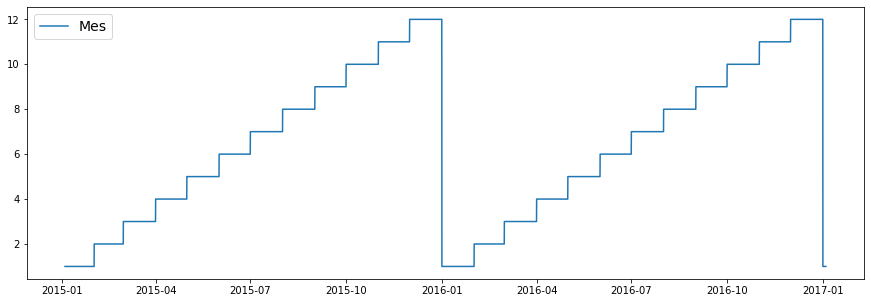

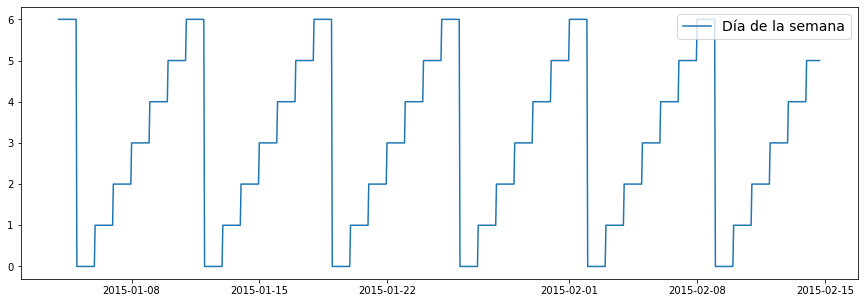

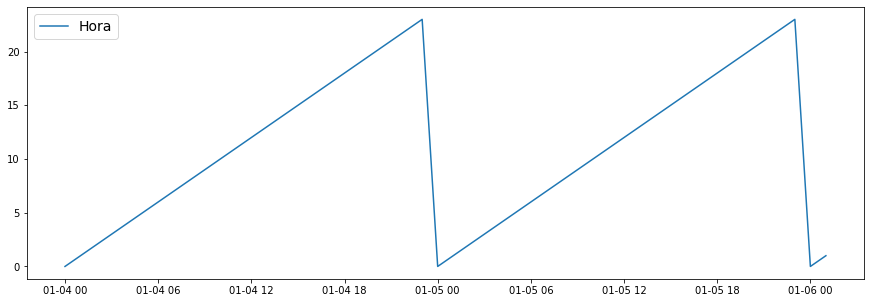

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(timestamp, mes, label='Mes')
plt.legend(fontsize=14);
plt.figure(figsize=(15,5))
plt.plot(timestamp[:1000], dia[:1000], label='Día de la semana')
plt.legend(fontsize=14);
plt.figure(figsize=(15,5))
plt.plot(timestamp[0:50], hora[0:50], label='Hora')
plt.legend(fontsize=14);

In [13]:
def encode_ciclicas(v, n_valores):
    x = np.cos(v/n_valores * 2*np.pi)
    y = np.sin(v/n_valores * 2*np.pi)
    return x, y

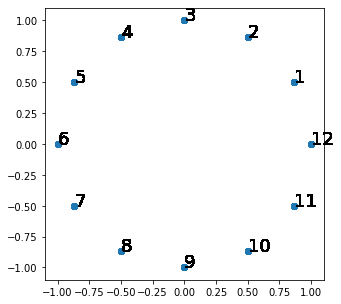

In [14]:
coords_x_mes, coords_y_mes = encode_ciclicas(mes, 12)
plt.figure(figsize=(5,5))
plt.plot(coords_x_mes, coords_y_mes, "o")
for cx,cy,texto in zip(coords_x_mes, coords_y_mes, mes):
    plt.text(cx,cy,texto, fontsize=18)

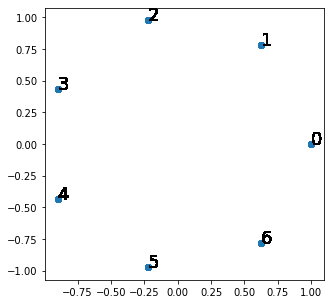

In [15]:
coords_x_day_of_week, coords_y_day_of_week = encode_ciclicas(dia, 7)
plt.figure(figsize=(5,5))
plt.plot(coords_x_day_of_week, coords_y_day_of_week, "o")
for cx,cy,texto in zip(coords_x_day_of_week, coords_y_day_of_week, dia):
    plt.text(cx,cy,texto, fontsize=18)

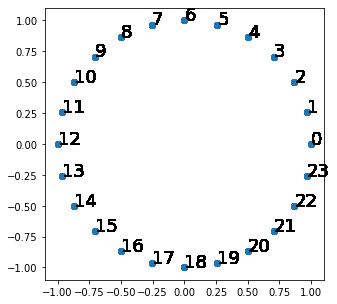

In [16]:
coords_x_hora, coords_y_hora = encode_ciclicas(hora, 24)
plt.figure(figsize=(5,5))
plt.plot(coords_x_hora, coords_y_hora, "o")
for cx,cy,texto in zip(coords_x_hora, coords_y_hora, hora):
    plt.text(cx,cy,texto, fontsize=18)

In [17]:

from sklearn.preprocessing import RobustScaler
f_columns = ['t1', 'hum', 'wind_speed']
f_transformer = RobustScaler()
f_transformer = f_transformer.fit(data[f_columns].to_numpy())
data.loc[:, f_columns] = f_transformer.transform(data[f_columns].to_numpy())

In [18]:
data.cnt.std()

1085.1080679362167

In [19]:
# Transformación de escala (ajustar el factor en función del problema)
def transform(x):
    return x/data.cnt.std()
def inverse_transform(x_escalado):
    return x_escalado*1085.10 #data.cnt.std()

In [20]:
def inverse_transform(x_escalado):
    return x_escalado*1085.10 #data.cnt.std()

In [21]:
data['cnt'] = transform(data['cnt'])

In [22]:
data['cnt'].max()

7.243518164000984

In [23]:
data.head(5)

,timestamp,cnt,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season,hour,day_of_week,day_of_month,month,year,year_month
0,2015-01-04 00:00:00,0.167725,-1.1875,2.0,0.925,-0.857143,3.0,0.0,1.0,3.0,0,6,4,1,2015,2015-01
1,2015-01-04 01:00:00,0.127176,-1.1875,2.5,0.925,-0.952381,1.0,0.0,1.0,3.0,1,6,4,1,2015,2015-01
2,2015-01-04 02:00:00,0.123490,-1.2500,2.5,1.100,-1.428571,1.0,0.0,1.0,3.0,2,6,4,1,2015,2015-01
3,2015-01-04 03:00:00,0.066353,-1.3125,2.0,1.275,-1.428571,1.0,0.0,1.0,3.0,3,6,4,1,2015,2015-01
4,2015-01-04 04:00:00,0.043314,-1.3125,0.0,0.925,-0.809524,1.0,0.0,1.0,3.0,4,6,4,1,2015,2015-01


In [24]:
target = data['cnt'].values
t1 = data['t1'].values
t2 = data['t2'].values
hum = data['hum'].values
viento = data['wind_speed'].values
tiempo = data['weather_code'].values
festivo = data['is_holiday'].values
#is_weekend
#season
#year
mes = data['month'].values
dia = data['day_of_week'].values
hora = data['hour'].values

estacion = data['season'].values
festivo = data['is_holiday'].values
timestamp = data["timestamp"].values
year_month = data["year_month"].values

In [ ]:
cnt	t1	t2	hum	wind_speed	weather_code	is_holiday	is_weekend	season	hour	day_of_week	day_of_month	month	year	year_month

SyntaxError: ignored

In [25]:
target_transf = transform(target)

series = [target_transf, t1, hum, viento, festivo]
se_saben_antes = [False, True, True, True, True]
nombres_series = ["target_transf", "t1", "hum", "wind_speed", "is_holiday"]

# Variables calendario sobre las que hemos la transformación cíclica
series.append(coords_x_mes)
nombres_series.append("coords_x_mes")
se_saben_antes.append(True)

series.append(coords_y_mes)
nombres_series.append("coords_y_mes")
se_saben_antes.append(True)

series.append(coords_x_hora)
nombres_series.append("coords_x_semana")
se_saben_antes.append(True)

series.append(coords_y_hora)
nombres_series.append("coords_y_hora")
se_saben_antes.append(True)

series.append(coords_x_day_of_week)
nombres_series.append("coords_x_dia")
se_saben_antes.append(True)

series.append(coords_y_day_of_week)
nombres_series.append("coords_y_dia")
se_saben_antes.append(True)

In [26]:
print(np.shape(series))
print(np.shape(se_saben_antes))

(11, 17414)
(11,)


In [27]:
series

[array([0.16772523, 0.12717627, 0.12349   , ..., 0.31056815, 0.20643105,
        0.12809784]),
 array([-1.1875, -1.1875, -1.25  , ..., -0.875 , -0.875 , -0.9375]),
 array([0.925, 0.925, 1.1  , ..., 0.2  , 0.075, 0.075]),
 array([-0.85714286, -0.95238095, -1.42857143, ...,  0.85714286,
         0.76190476,  0.66666667]),
 array([0., 0., 0., ..., 0., 0., 0.]),
 array([0.8660254, 0.8660254, 0.8660254, ..., 0.8660254, 0.8660254,
        0.8660254]),
 array([0.5, 0.5, 0.5, ..., 0.5, 0.5, 0.5]),
 array([1.        , 0.96592583, 0.8660254 , ..., 0.70710678, 0.8660254 ,
        0.96592583]),
 array([ 0.        ,  0.25881905,  0.5       , ..., -0.70710678,
        -0.5       , -0.25881905]),
 array([0.6234898, 0.6234898, 0.6234898, ..., 0.6234898, 0.6234898,
        0.6234898]),
 array([-0.78183148, -0.78183148, -0.78183148, ...,  0.78183148,
         0.78183148,  0.78183148])]

In [28]:
from my_utils_series_temporales import NAN, int2dummy, enventanar, info_enventanado

In [29]:
lookback = 48 # lookback es otro sinónimo de W_in (LAG)
time_step = 24 # valores a predecir (N_AHEAD, N_OUTPUTS)

# target=0 en siguiente línea quiere decir cuál es el índice del target en objeto "series":
X, y = enventanar(series, target=0, se_saben_antes=se_saben_antes,
                  W_in=lookback, W_out = time_step)

print(X.shape, np.shape(y))

(17414, 48, 11) (17414, 24)


In [30]:
print(X.shape)
print(np.shape(target))

(17414, 48, 11)
(17414,)


In [31]:
info_enventanado(X[:10],y[:10],
                 nombres_series=nombres_series,
                 nombre_target="target",
                 tiempos=timestamp)

10 ventanas creadas

X.shape=(10, 48, 11)  Y.shape=(10, 24) 

 Ventana 0: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,?45,?46,?47
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490


 Ventana 1: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,?45,?46,2015-01-04T00:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490


 Ventana 2: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,?45,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490


 Ventana 3: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490


 Ventana 4: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 5: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 6: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 7: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000,2015-01-04T06:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392,0.047000
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500,-1.437500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905,-0.761905
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000,-0.258819
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000,0.965926
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 8: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000,2015-01-04T06:00:00.000000000,2015-01-04T07:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392,0.047000,0.069118
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500,-1.437500,-1.375000
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000,1.275000,1.100000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905,-0.761905,-0.666667
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000,-0.258819,-0.500000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000,0.965926,0.866025
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 9: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000,2015-01-04T06:00:00.000000000,2015-01-04T07:00:00.000000000,2015-01-04T08:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392,0.047000,0.069118,0.120725
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500,-1.437500,-1.375000,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000,1.275000,1.100000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905,-0.761905,-0.666667,-0.571429
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000,-0.258819,-0.500000,-0.707107
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000,0.965926,0.866025,0.707107
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


In [32]:
y.shape

(17414, 24)

In [33]:
y2 = y[:-24] #elimino los últimos time_step al tener NAN
X2 = X[:-24]#elimino los últimos time_step al tener NAN
target2 = target[:-24] #elimino los últimos time_step al tener NAN
timestamp2 = timestamp[:-24] #elimino los últimos time_step al tener NAN

In [35]:
print(y2.shape)
print(X2.shape)
print(target2.shape)
print(timestamp2.shape)

(17390, 24)
(17390, 48, 11)
(17390,)
(17390,)


 Separación training-test

In [71]:
train_perc  = .8
punto_corte = int(len(X)*train_perc)


X_train      = X2[lookback:punto_corte]      # elimino los lookback primeros al tener NANs
y_train      = y2[lookback:punto_corte]      # elimino los lookback primeros al tener NANs
target_train = target2[lookback:punto_corte] # elimino los lookback primeros al tener NANs
fechas_train = timestamp2[lookback:punto_corte] # elimino los lookback primeros al tener NANs

X_test       = X[punto_corte:]
y_test       = y[punto_corte:]
target_test  = target[punto_corte:]
fechas_test  = timestamp2[punto_corte:]

print(np.shape(target_train))
print(np.shape(target_test))

(13883,)
(3483,)


In [ ]:
len(target_test) + len(target_train)

17366

In [37]:
from pandas import DataFrame

In [38]:
DataFrame(fechas_train)

,0
0,2015-01-06 00:00:00
1,2015-01-06 01:00:00
2,2015-01-06 02:00:00
3,2015-01-06 03:00:00
4,2015-01-06 04:00:00
...,...
13878,2016-08-09 22:00:00
13879,2016-08-09 23:00:00
13880,2016-08-10 00:00:00
13881,2016-08-10 01:00:00


In [39]:
DataFrame(fechas_test)

,0
0,2016-08-10 03:00:00
1,2016-08-10 04:00:00
2,2016-08-10 05:00:00
3,2016-08-10 06:00:00
4,2016-08-10 07:00:00
...,...
3454,2017-01-02 19:00:00
3455,2017-01-02 20:00:00
3456,2017-01-02 21:00:00
3457,2017-01-02 22:00:00


In [ ]:
print(X_train.shape, y_train.shape)

(13883, 48, 11) (13883, 24)


In [40]:
lookback, X_train.shape[-1]

(48, 11)

 Construcción del modelo con Keras

In [41]:
def vanilla_multistep_LSTM():
    model = Sequential()  
    model.add(LSTM(units=50, input_shape=(lookback, X_train.shape[-1])))
    model.add(Dense(time_step))
    return model

In [42]:
loss = 'mean_squared_error'
optimizer = "adam"

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

In [43]:
model = vanilla_multistep_LSTM()
model.summary()
model.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

import keras.backend as K
print(K.get_value(model.optimizer.lr))

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 50)                12400     
                                                                 
 dense (Dense)               (None, 24)                1224      
                                                                 
Total params: 13,624
Trainable params: 13,624
Non-trainable params: 0
_________________________________________________________________
0.001


In [45]:
history_model_0 = model.fit(X_train, y_train, epochs=35, validation_split=0.1, batch_size=32)

Epoch 1/35
391/391 [==============================] - 12s 30ms/step - loss: 0.4209 - mse: 0.4209 - val_loss: 0.4142 - val_mse: 0.4142
Epoch 2/35
391/391 [==============================] - 10s 26ms/step - loss: 0.2525 - mse: 0.2525 - val_loss: 0.3120 - val_mse: 0.3120
Epoch 3/35
391/391 [==============================] - 10s 26ms/step - loss: 0.1994 - mse: 0.1994 - val_loss: 0.2513 - val_mse: 0.2513
Epoch 4/35
391/391 [==============================] - 10s 26ms/step - loss: 0.1681 - mse: 0.1681 - val_loss: 0.2440 - val_mse: 0.2440
Epoch 5/35
391/391 [==============================] - 10s 26ms/step - loss: 0.1522 - mse: 0.1522 - val_loss: 0.2242 - val_mse: 0.2242
Epoch 6/35
391/391 [==============================] - 10s 26ms/step - loss: 0.1432 - mse: 0.1432 - val_loss: 0.2048 - val_mse: 0.2048
Epoch 7/35
391/391 [==============================] - 10s 26ms/step - loss: 0.1358 - mse: 0.1358 - val_loss: 0.2001 - val_mse: 0.2001
Epoch 8/35
391/391 [==============================] - 10s 26ms

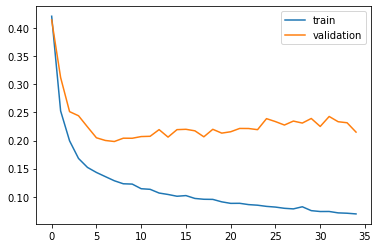

In [46]:
plt.plot(history_model_0.history['loss'], label='train')
plt.plot(history_model_0.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [ ]:
#lookback  ---> n_lag
#time_step ---> n_seq

In [47]:
from math import sqrt
from sklearn.metrics import mean_squared_error

In [58]:
from pandas import DataFrame

In [ ]:
DataFrame(y_test).tail(23)

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
3460,0.045157,0.039627,0.009216,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,...,0.778724,1.106802,2.526937,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN
3461,0.039627,0.009216,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,...,1.106802,2.526937,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN
3462,0.009216,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,...,2.526937,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN
3463,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,...,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN
3464,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,...,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN
3465,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,...,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN,NaN
3466,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,...,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3467,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,2.526937,...,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3468,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,2.526937,2.045879,...,0.128098,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3469,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,2.526937,2.045879,0.960273,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [64]:
from math import sqrt

In [65]:
# Prediction
y_pred = model.predict(X_test)

In [73]:
print(y_pred.shape)
print(y_test.shape)
print(y_pred_.shape)
print(y_test_.shape)

(3483, 24)
(3483, 24)
(3460, 24)
(3460, 24)


In [72]:
y_pred_ = y_pred[0:-23,:]
y_test_ = y_test[0:-23,:]

for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.23399851186896944
Train RMSE: 0.2873754322373242
Train RMSE: 0.3195051382088827
Train RMSE: 0.3447511699351117
Train RMSE: 0.35022542875983764
Train RMSE: 0.36175853242787753
Train RMSE: 0.38101785373240293
Train RMSE: 0.3935079045383251
Train RMSE: 0.400787298282411
Train RMSE: 0.4100869078984297
Train RMSE: 0.41786045194778426
Train RMSE: 0.4293784304589672
Train RMSE: 0.4321586650853061
Train RMSE: 0.4402570107966638
Train RMSE: 0.4370994424762437
Train RMSE: 0.42640833398810274
Train RMSE: 0.42917860789205453
Train RMSE: 0.4287390240028531
Train RMSE: 0.433644617941765
Train RMSE: 0.44141651181407104
Train RMSE: 0.44598879231998284
Train RMSE: 0.44674082590335434
Train RMSE: 0.44263966801805305
Train RMSE: 0.4392064724493458


In [78]:
from sklearn.metrics import mean_squared_error, explained_variance_score, max_error

In [80]:
for i in range(len(y_pred[0,:])):
  print('Explained variance score:', explained_variance_score(y_test_[:,i], y_pred_[:,i]))

Explained variance score: 0.9515555430337691
Explained variance score: 0.9253118331171978
Explained variance score: 0.9075845295079208
Explained variance score: 0.893737970983825
Explained variance score: 0.8902489318343947
Explained variance score: 0.8824435330187461
Explained variance score: 0.8677787033349613
Explained variance score: 0.858473575685051
Explained variance score: 0.8530778555084694
Explained variance score: 0.8460660571885206
Explained variance score: 0.839512741389218
Explained variance score: 0.8303628466766386
Explained variance score: 0.8279159919906726
Explained variance score: 0.8220528861025571
Explained variance score: 0.8249564769140212
Explained variance score: 0.8344433268841848
Explained variance score: 0.8326482326943712
Explained variance score: 0.8312601108554721
Explained variance score: 0.8270755680231695
Explained variance score: 0.8203740796669508
Explained variance score: 0.8161176235575002
Explained variance score: 0.8166784907871678
Explained var

In [81]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(max_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 1.3629636148617263
Train RMSE: 1.5434894648921205
Train RMSE: 1.581281540866432
Train RMSE: 1.5895456005595534
Train RMSE: 1.5768223239392338
Train RMSE: 1.7061778021596596
Train RMSE: 1.6963674196877556
Train RMSE: 1.7455505283687114
Train RMSE: 1.8419859584003018
Train RMSE: 1.8935133102905233
Train RMSE: 1.844898346444049
Train RMSE: 1.8990032735512075
Train RMSE: 1.841957412257842
Train RMSE: 1.8965105086575895
Train RMSE: 1.8911341468481528
Train RMSE: 1.9189574113797496
Train RMSE: 1.9089665130901206
Train RMSE: 1.92792223352116
Train RMSE: 1.9000945297169929
Train RMSE: 1.907648480941483
Train RMSE: 1.9130287031564936
Train RMSE: 1.8924732795495074
Train RMSE: 1.8532429164331532
Train RMSE: 1.929339575018692


Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

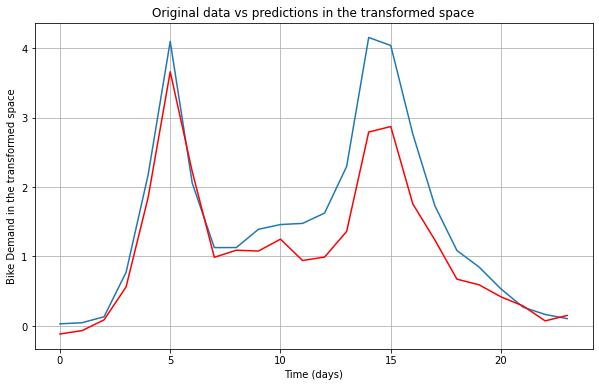

In [82]:
# Prediction
y_pred = model.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (days)')
plt.ylabel('Bike Demand in the transformed space')
plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

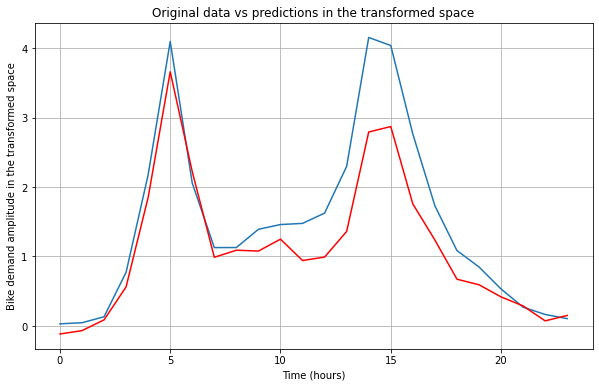

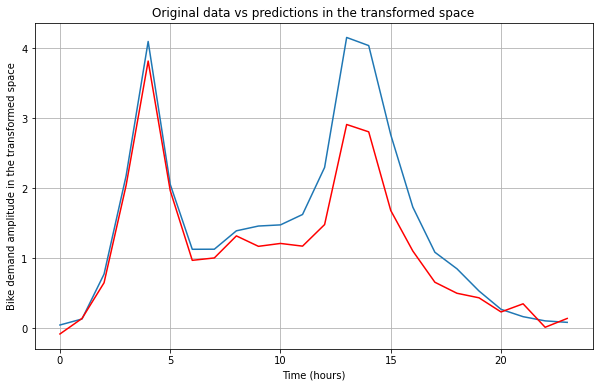

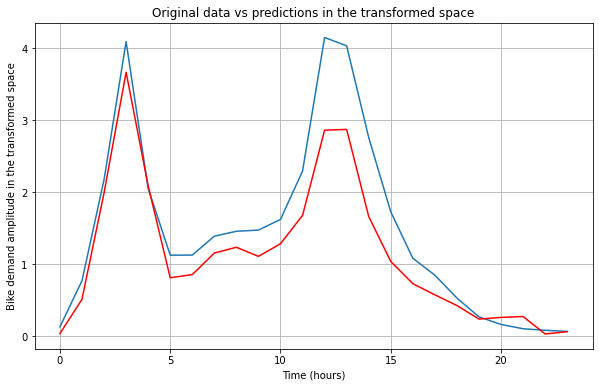

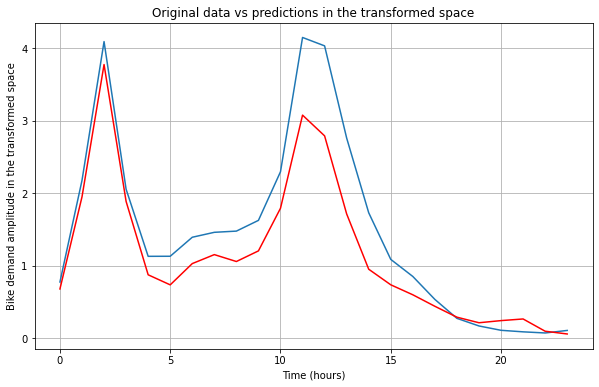

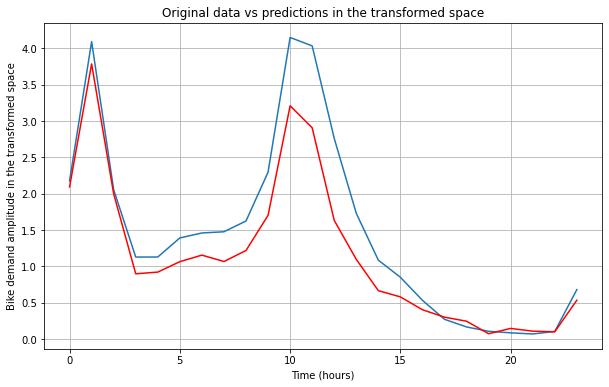

...

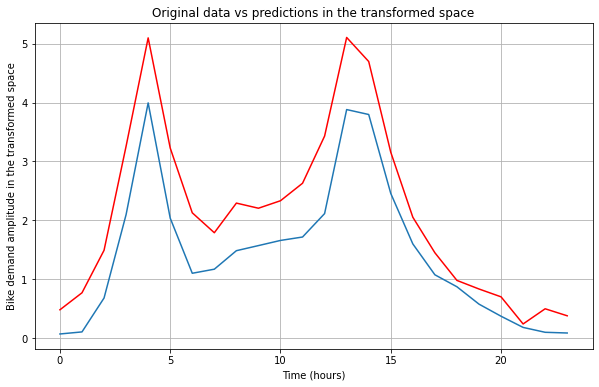

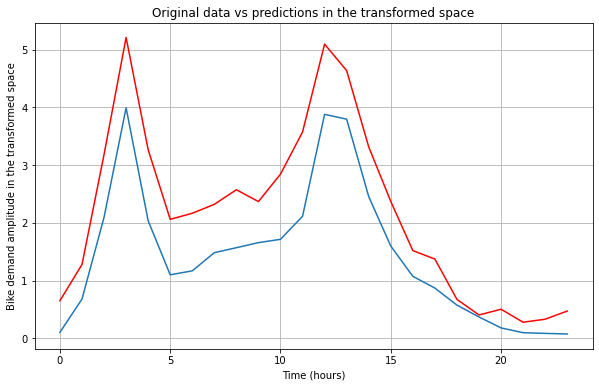

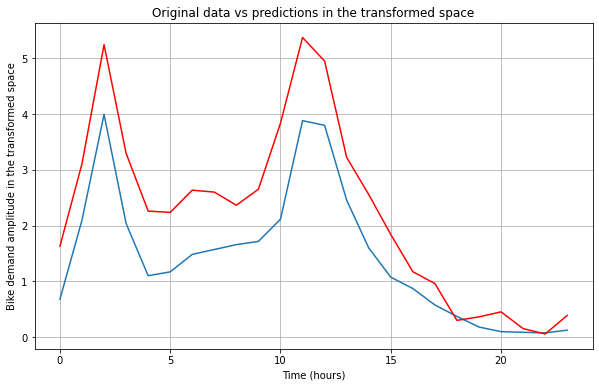

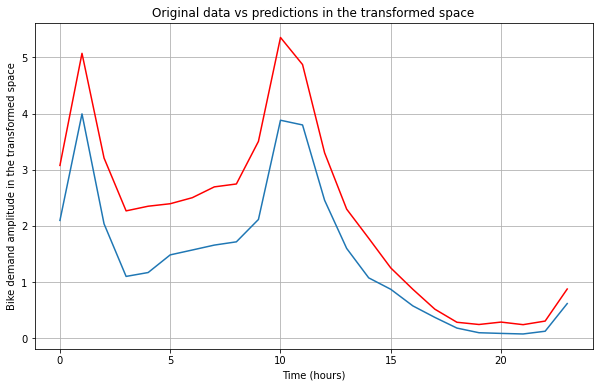

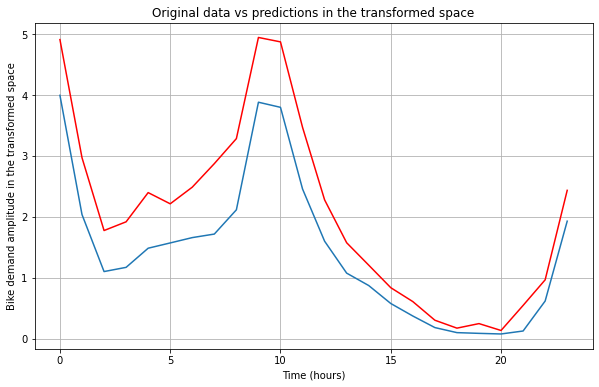

In [87]:
for i in range(0,30):
  the_day = i
  y_pred_days = y_pred[the_day,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_day,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [84]:
model.save('model_vanilla.h5')

In [86]:
print(X_train.shape[1])
print(X_train.shape[2])
print(y_train.shape[1])

48
11
24


In [ ]:
n_timesteps, n_features, n_outputs = X_train.shape[1], X_train.shape[2], y_train.shape[1]

In [ ]:
model_0 = Sequential()
model_0.add(LSTM(200, activation='relu', input_shape=(n_timesteps, n_features)))  # input_shape=[time steps, features]
model_0.add(Dense(100, activation='relu'))
model_0.add(Dense(n_outputs))
model_0.compile(loss='mean_squared_error', metrics=['mse'], optimizer='adam')

In [ ]:
model_0.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (None, 200)               169600    
                                                                 
 dense_11 (Dense)            (None, 100)               20100     
                                                                 
 dense_12 (Dense)            (None, 24)                2424      
                                                                 
Total params: 192,124
Trainable params: 192,124
Non-trainable params: 0
_________________________________________________________________


In [ ]:
history_model_0 = model_0.fit(X_train, y_train, epochs=35, validation_split=0.1, batch_size=32)

Epoch 1/35
391/391 [==============================] - 45s 110ms/step - loss: nan - mse: nan - val_loss: nan - val_mse: nan
Epoch 2/35
159/391 [===========>..................] - ETA: 23s - loss: nan - mse: nan

KeyboardInterrupt: ignored

probando

In [ ]:
# Prediction
y_pred = model.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_hour = 0
y_pred_hour = y_pred[the_day,:]


NameError: ignored

In [ ]:
y_pred

array([[-0.05594212, -0.01673202,  0.26441845, ...,  0.19075108,
         0.20941885, -0.01141405],
       [ 0.01078567,  0.19675684,  0.7828093 , ...,  0.12865308,
        -0.02761573, -0.02626342],
       [ 0.15965058,  0.79480594,  2.4489532 , ...,  0.07361817,
         0.20814891,  0.09050679],
       ...,
       [ 0.45599782,  0.38918313,  0.3346392 , ...,  1.9591632 ,
         1.0967755 ,  0.5487582 ],
       [ 0.29884946,  0.22998245,  0.1809567 , ...,  1.0417607 ,
         0.6263505 ,  0.45428747],
       [ 0.22318567,  0.12923798,  0.05836874, ...,  0.66363704,
         0.40307012,  0.17764473]], dtype=float32)

KeyboardInterrupt: ignored

Exception ignored in: 'zmq.backend.cython.message.Frame.__dealloc__'
Traceback (most recent call last):
  File "zmq/backend/cython/checkrc.pxd", line 13, in zmq.backend.cython.checkrc._check_rc
KeyboardInterrupt
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipy

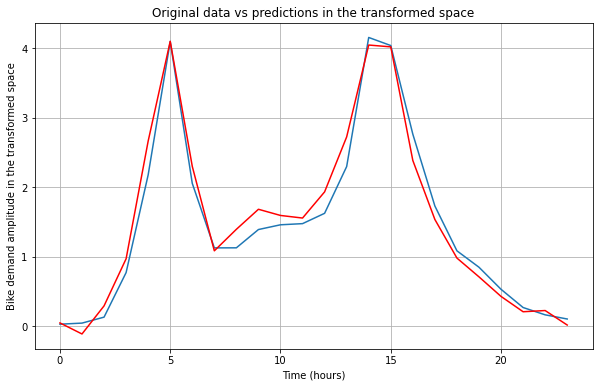

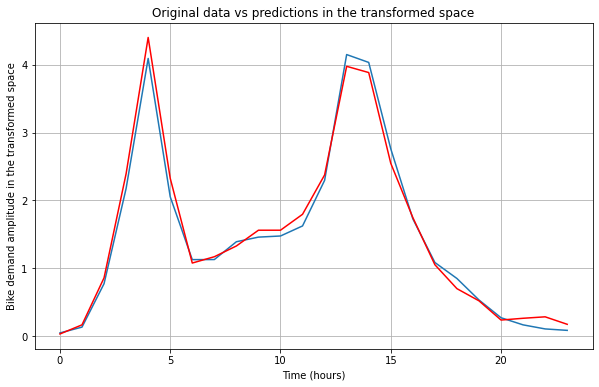

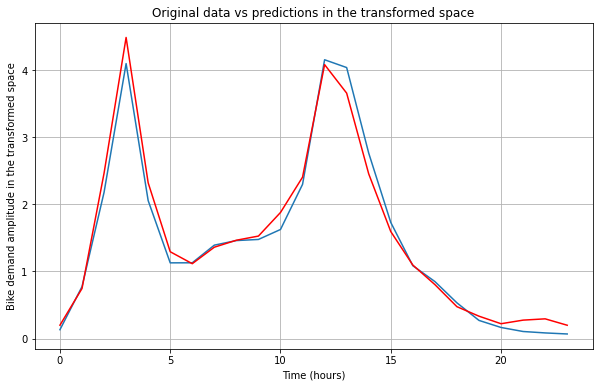

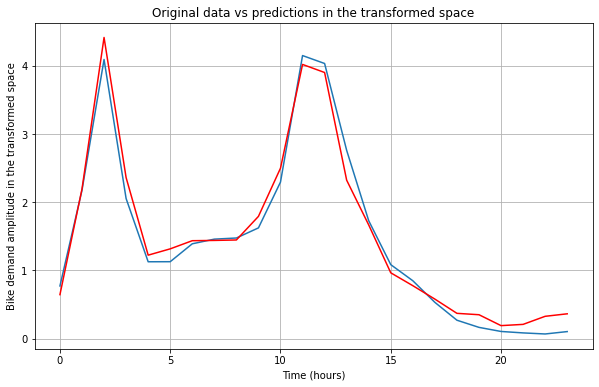

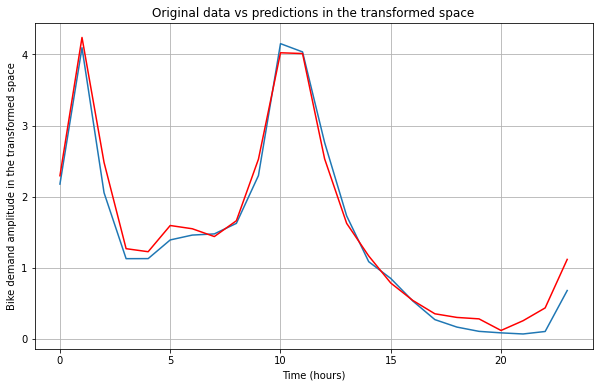

...

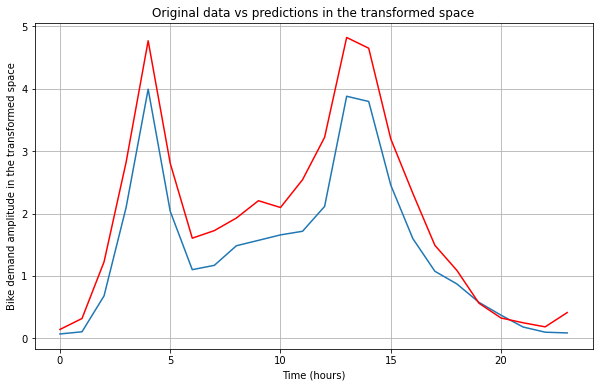

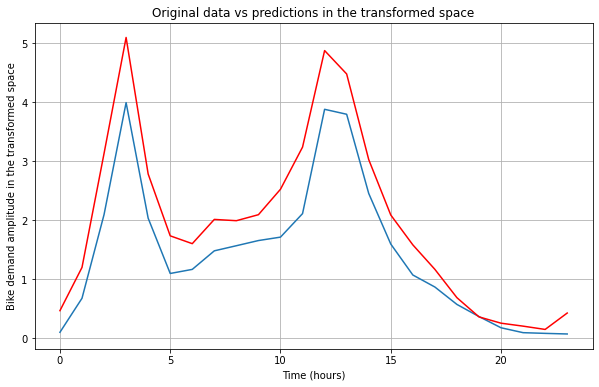

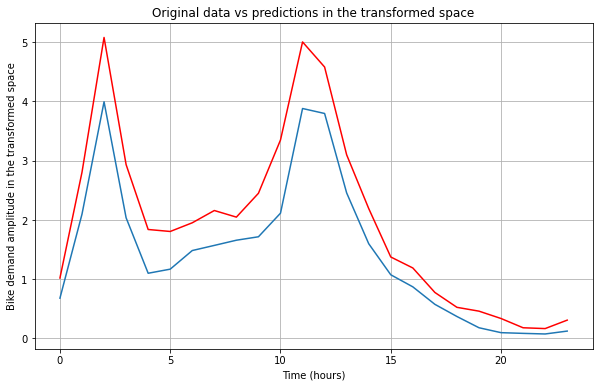

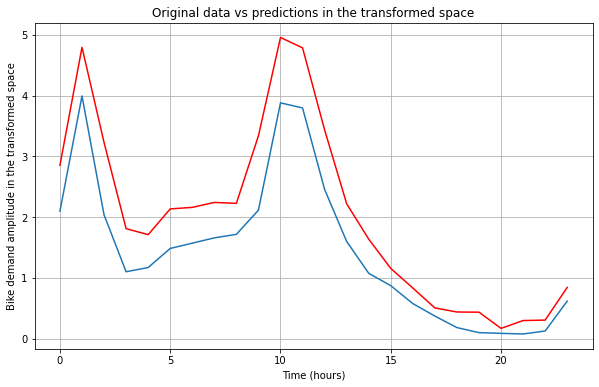

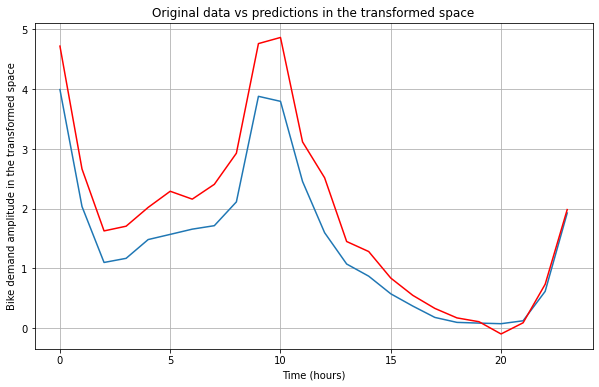

In [ ]:
for i in range(0,30):
  the_day = i
  y_pred_days = y_pred[the_day,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_day,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

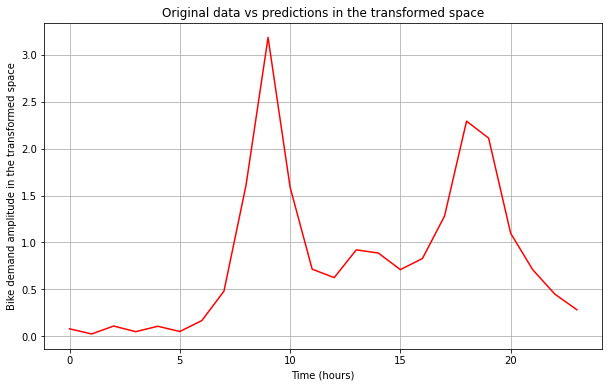

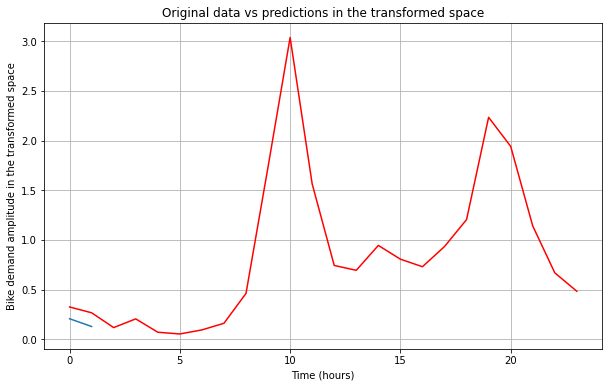

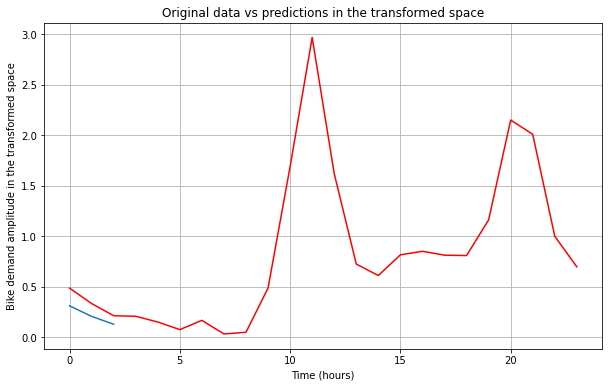

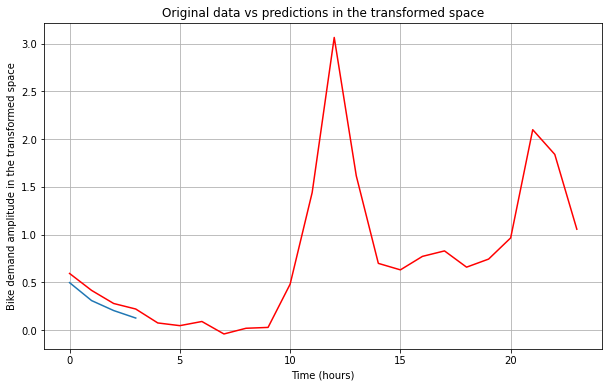

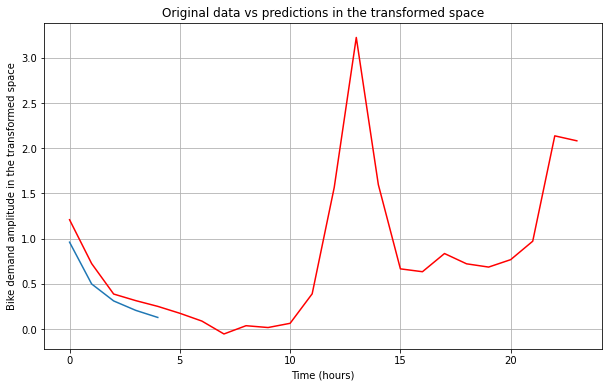

...

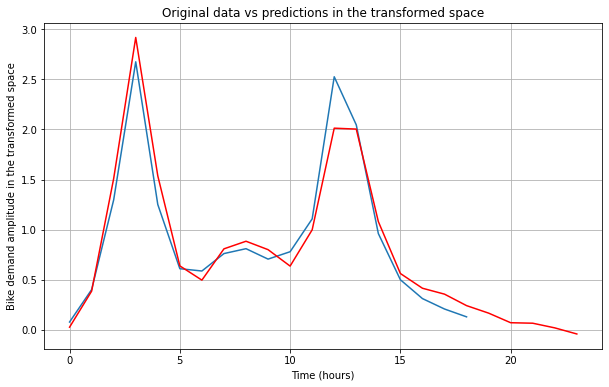

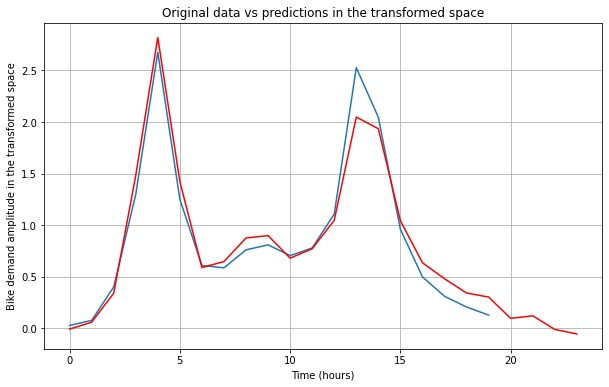

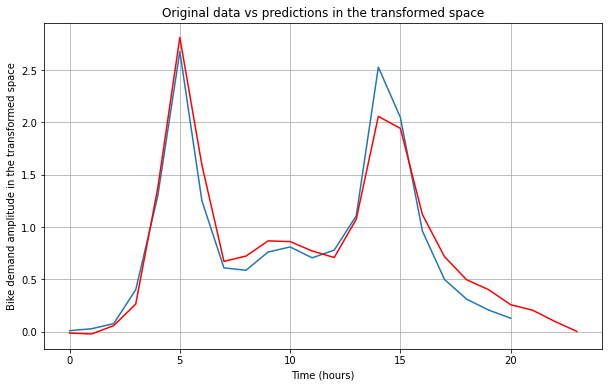

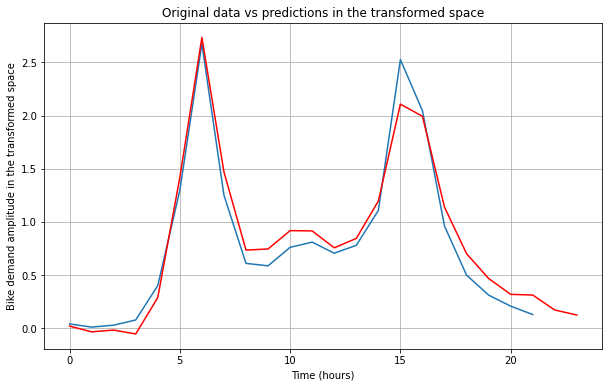

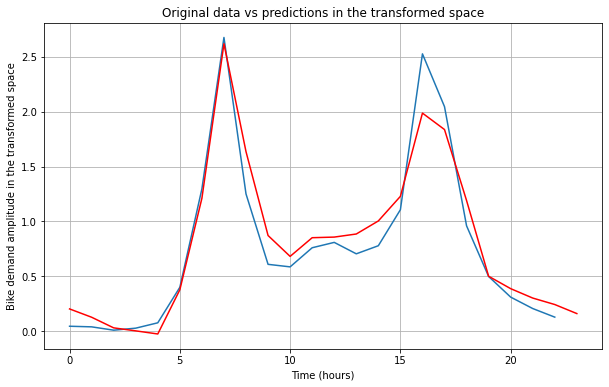

In [ ]:
for i in range(1,24):
  the_hour = -i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

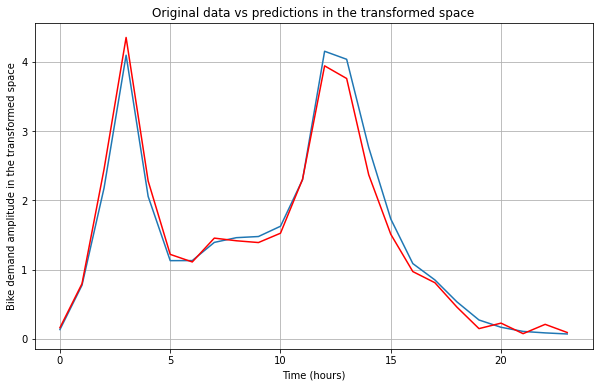

In [ ]:
the_day = 2
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (hours)')
plt.ylabel('Bike demand amplitude in the transformed space')
plt.title('Original data vs predictions in the transformed space')

Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

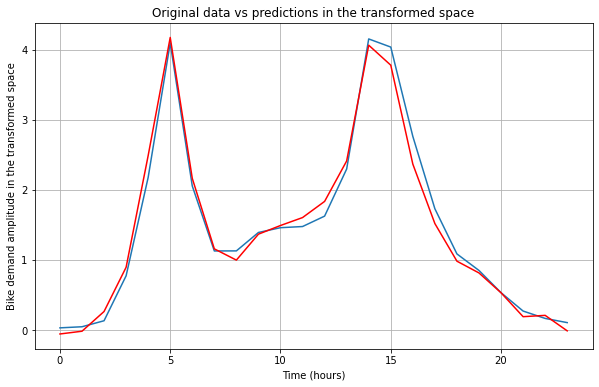

In [ ]:
the_day = 0
plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (hours)')
plt.ylabel('Bike demand amplitude in the transformed space')
plt.title('Original data vs predictions in the transformed space')

Chequeo

In [ ]:
y_train_prediction = model.predict(X_train)
y_test_prediction = model.predict(X_test)

In [ ]:
y_train_prediction.shape

(13883, 24)

In [ ]:
target_train_pred = inverse_transform(y_train_prediction)
target_test_pred  = inverse_transform(y_test_prediction)

In [ ]:
y_test_inv = inverse_transform(y_test)

In [ ]:
target_train_pred.shape

(13883, 24)

In [ ]:
y_train_prediction

array([[ 0.11859745,  0.12764654,  0.04211043, ...,  0.56862533,
         0.41495246,  0.29291603],
       [ 0.02799015,  0.0485474 ,  0.04224458, ...,  0.48202094,
         0.2922027 ,  0.19090441],
       [ 0.0343588 ,  0.04386388, -0.00711916, ...,  0.31824735,
         0.12140697,  0.11433038],
       ...,
       [ 0.1472924 ,  0.06550334,  0.11861002, ...,  0.80561507,
         0.70152545,  0.7037877 ],
       [-0.02739336, -0.00685152, -0.03452538, ...,  0.57948756,
         0.3002407 ,  0.2859222 ],
       [-0.15073834, -0.00273833,  0.04724509, ...,  0.449693  ,
         0.14806886,  0.15408781]], dtype=float32)

In [ ]:
target_train_pred

array([[ 128.6901   ,  138.50925  ,   45.694023 , ...,  617.0153   ,
         450.2649   ,  317.84317  ],
       [  30.372108 ,   52.678783 ,   45.839596 , ...,  523.0409   ,
         317.06915  ,  207.15038  ],
       [  37.282734 ,   47.59669  ,   -7.7250047, ...,  345.3302   ,
         131.73871  ,  124.05989  ],
       ...,
       [ 159.82698  ,   71.077675 ,  128.70374  , ...,  874.1729   ,
         761.2252   ,  763.68     ],
       [ -29.72453  ,   -7.4345884,  -37.46349  , ...,  628.80194  ,
         325.79117  ,  310.25418  ],
       [-163.56618  ,   -2.9713583,   51.26564  , ...,  487.96185  ,
         160.66951  ,  167.20068  ]], dtype=float32)

In [ ]:
# Parece que me salen predicciones negativas y no pueden haberlas, como mucho tendríamos predicciones en 0 (días de tormenta)

Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

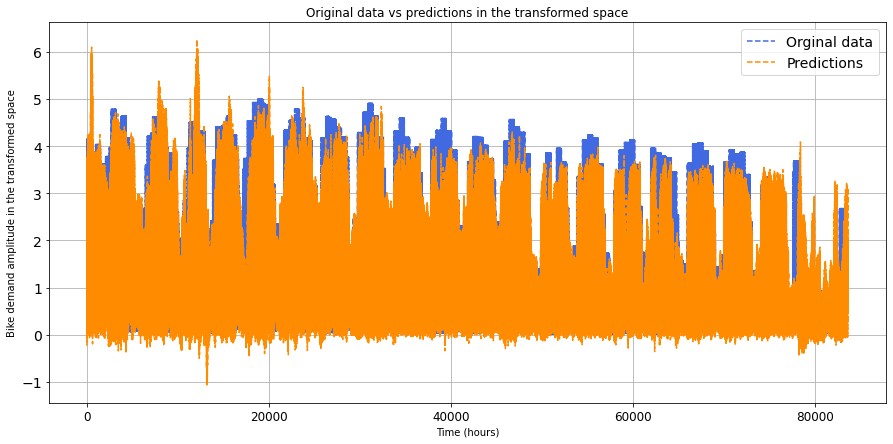

In [ ]:
y_ = y_test.flatten()
y_pred_days_ = y_pred_days.flatten()

plt.figure(figsize=(15,7))
plt.grid(True)
plt.plot(y_test.flatten(),'--', c='royalblue', label='Orginal data')
plt.plot(y_test_prediction.flatten(), '--', c='darkorange', label='Predictions')
plt.xticks(fontsize=12)
plt.yticks(fontsize=14)
#plt.xlim([fechas_train[100],fechas_train[200]])
plt.legend(fontsize=14);

plt.xlabel('Time (hours)')
plt.ylabel('Bike demand amplitude in the transformed space')
plt.title('Original data vs predictions in the transformed space')

# LSTM multiple

In [88]:
def multistep_LSTM():

  # The LSTM architecture
  model = Sequential()
  # First LSTM layer with Dropout regularisation
  model.add(LSTM(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1])))
  model.add(Dropout(0.2))
  # Second LSTM layer
  #model.add(LSTM(units=50, return_sequences=True))
  #model.add(Dropout(0.2))
  # Third LSTM layer
  model.add(LSTM(units=50, return_sequences=True))
  model.add(Dropout(0.2))
  # Fourth LSTM layer
  model.add(LSTM(units=50))
  model.add(Dropout(0.2))
  # The output layer
  model.add(Dense(time_step))
  return model

In [89]:
loss = 'mean_squared_error'
optimizer = "adam"

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

In [90]:
model_2 = multistep_LSTM()
model_2.summary()
model_2.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

import keras.backend as K
print(K.get_value(model_2.optimizer.lr))

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 48, 50)            12400     
                                                                 
 dropout (Dropout)           (None, 48, 50)            0         
                                                                 
 lstm_2 (LSTM)               (None, 48, 50)            20200     
                                                                 
 dropout_1 (Dropout)         (None, 48, 50)            0         
                                                                 
 lstm_3 (LSTM)               (None, 50)                20200     
                                                                 
 dropout_2 (Dropout)         (None, 50)                0         
                                                                 
 dense_1 (Dense)             (None, 24)               

In [91]:
history_model_2 = model_2.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=35)

Epoch 1/25
357/357 [==============================] - 43s 93ms/step - loss: 0.6332 - mse: 0.6332 - val_loss: 0.4478 - val_mse: 0.4478
Epoch 2/25
357/357 [==============================] - 32s 89ms/step - loss: 0.3356 - mse: 0.3356 - val_loss: 0.3287 - val_mse: 0.3287
Epoch 3/25
357/357 [==============================] - 32s 89ms/step - loss: 0.2703 - mse: 0.2703 - val_loss: 0.2819 - val_mse: 0.2819
Epoch 4/25
357/357 [==============================] - 31s 88ms/step - loss: 0.2384 - mse: 0.2384 - val_loss: 0.2844 - val_mse: 0.2844
Epoch 5/25
357/357 [==============================] - 32s 88ms/step - loss: 0.2177 - mse: 0.2177 - val_loss: 0.3397 - val_mse: 0.3397
Epoch 6/25
357/357 [==============================] - 31s 87ms/step - loss: 0.2022 - mse: 0.2022 - val_loss: 0.2508 - val_mse: 0.2508
Epoch 7/25
357/357 [==============================] - 31s 88ms/step - loss: 0.1886 - mse: 0.1886 - val_loss: 0.2531 - val_mse: 0.2531
Epoch 8/25
357/357 [==============================] - 31s 88ms

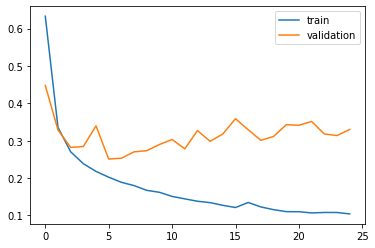

In [92]:
plt.plot(history_model_2.history['loss'], label='train')
plt.plot(history_model_2.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [120]:
model_2.save('multistep_LSTM.h5')

In [112]:
y_pred = model_2.predict(X_test)

print(y_pred.shape)
print(y_test.shape)
print(y_pred_.shape)
print(y_test_.shape)

(3483, 24)
(3483, 24)
(3460, 24)
(3460, 24)


In [113]:
y_pred_ = y_pred[0:-23,:]
y_test_ = y_test[0:-23,:]

In [114]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))


Train RMSE: 0.4598190618682184
Train RMSE: 0.47471842454616925
Train RMSE: 0.48472377298899805
Train RMSE: 0.5033843054796721
Train RMSE: 0.5148352242350202
Train RMSE: 0.5284188631538261
Train RMSE: 0.5358548585919607
Train RMSE: 0.5430899414150384
Train RMSE: 0.5458213412376004
Train RMSE: 0.5482167435174445
Train RMSE: 0.5480872575684747
Train RMSE: 0.5542266966759822
Train RMSE: 0.556454701642234
Train RMSE: 0.5565684255762913
Train RMSE: 0.5663687798958978
Train RMSE: 0.5648878110161312
Train RMSE: 0.5648497329736072
Train RMSE: 0.5796716990379932
Train RMSE: 0.5775786744271563
Train RMSE: 0.5823474478037097
Train RMSE: 0.5783901412098844
Train RMSE: 0.5868124157464114
Train RMSE: 0.5810969894089139
Train RMSE: 0.5694575437279474


In [115]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(max_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 1.7161153177423258
Train RMSE: 1.802881072264514
Train RMSE: 1.8201045631976394
Train RMSE: 1.8580388154874241
Train RMSE: 1.8744489501981036
Train RMSE: 1.932916172467878
Train RMSE: 1.913142236675501
Train RMSE: 1.899504421231307
Train RMSE: 1.9145295182747872
Train RMSE: 1.9164143968989193
Train RMSE: 1.8769940746127594
Train RMSE: 1.9228331036733353
Train RMSE: 1.9293531836927509
Train RMSE: 1.9323583958939143
Train RMSE: 1.909846993258853
Train RMSE: 1.902286568452792
Train RMSE: 1.906082850126923
Train RMSE: 1.90652698378528
Train RMSE: 1.9033147701407969
Train RMSE: 1.9224555842615783
Train RMSE: 1.9160406834491122
Train RMSE: 1.9447795036426008
Train RMSE: 1.9925316313472214
Train RMSE: 2.0037028640936327


In [116]:
for i in range(len(y_pred[0,:])):
  print('Explained variance score:', explained_variance_score(y_test_[:,i], y_pred_[:,i]))

Explained variance score: 0.8091353669940081
Explained variance score: 0.7972864679763103
Explained variance score: 0.7887581056919288
Explained variance score: 0.7727058203781674
Explained variance score: 0.7619961552930621
Explained variance score: 0.7490120349476883
Explained variance score: 0.7409948774342201
Explained variance score: 0.7350453394336445
Explained variance score: 0.7305503720010833
Explained variance score: 0.7273843802290207
Explained variance score: 0.7272645180598206
Explained variance score: 0.7209326824162723
Explained variance score: 0.7179865105961498
Explained variance score: 0.7187561717851165
Explained variance score: 0.7086563922623403
Explained variance score: 0.7106567247123646
Explained variance score: 0.7106902524212825
Explained variance score: 0.6946347723757429
Explained variance score: 0.6963118917240017
Explained variance score: 0.6908334109112362
Explained variance score: 0.6954725657552684
Explained variance score: 0.6857079543298741
Explained 

Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

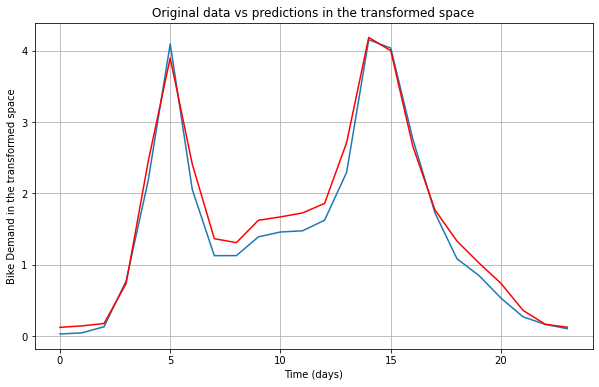

In [ ]:
# Prediction
y_pred = model_2.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (days)')
plt.ylabel('Bike Demand in the transformed space')
plt.title('Original data vs predictions in the transformed space')

In [ ]:
# evaluate the RMSE for each forecast time step
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
	for i in range(n_seq):
		actual = test[:,(n_lag+i)]
		predicted = [forecast[i] for forecast in forecasts]
		rmse = sqrt(mean_squared_error(actual, predicted))
		print('t+%d RMSE: %f' % ((i+1), rmse))

In [ ]:
lookback

48

In [ ]:
n_outputs

24

In [ ]:
'''
# Prediction
y_pred = model_2.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_hour = 0
y_pred_hour = y_pred[the_day,:]
'''

In [ ]:
from math import sqrt

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

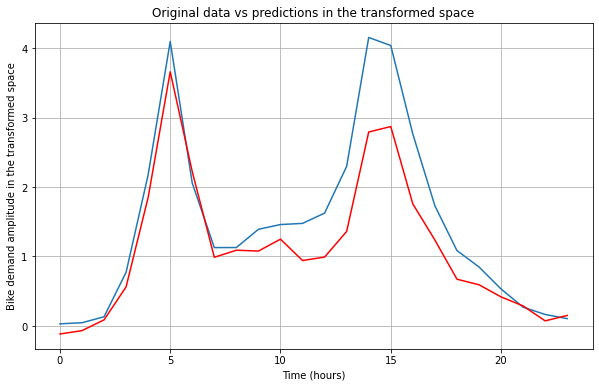

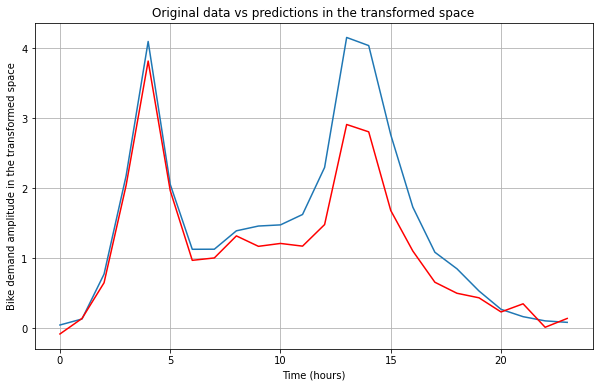

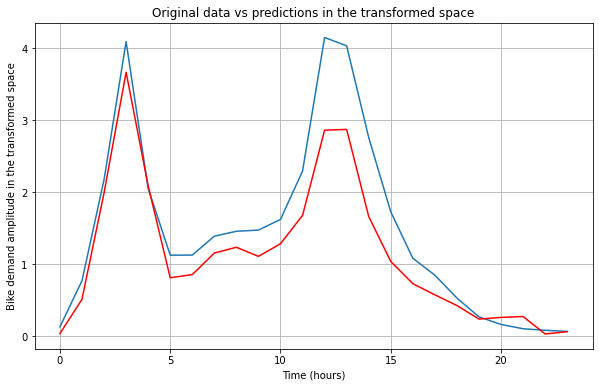

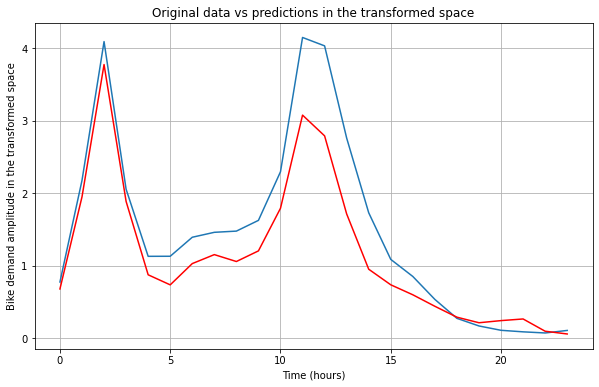

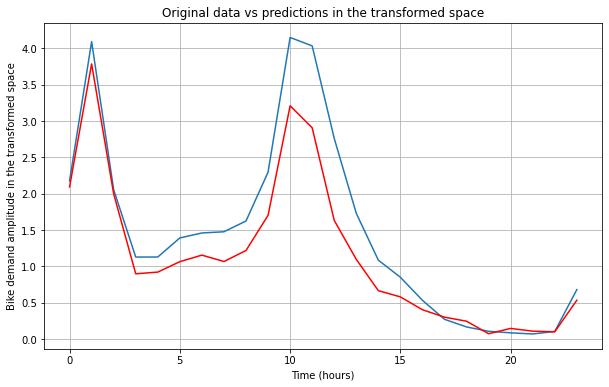

...

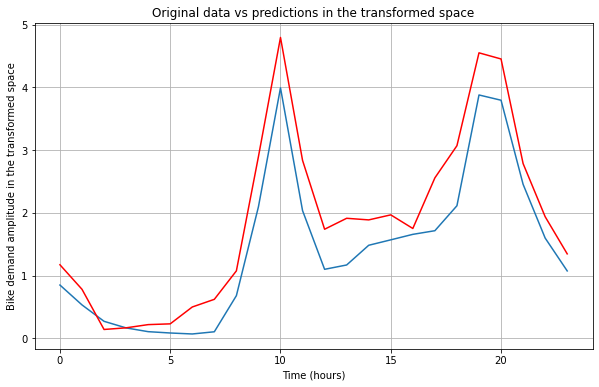

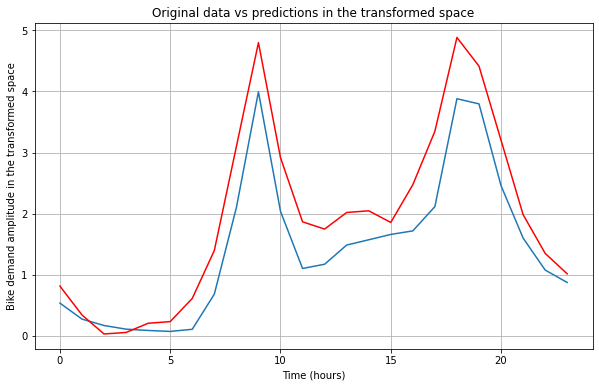

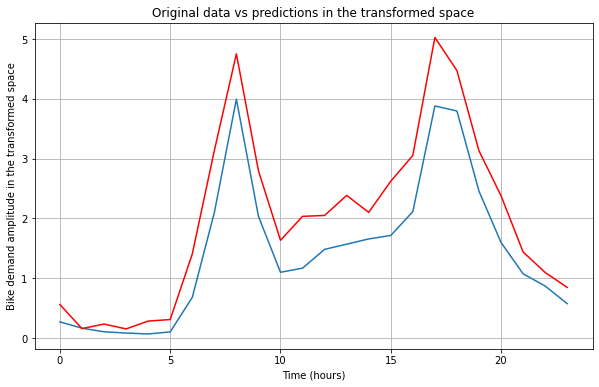

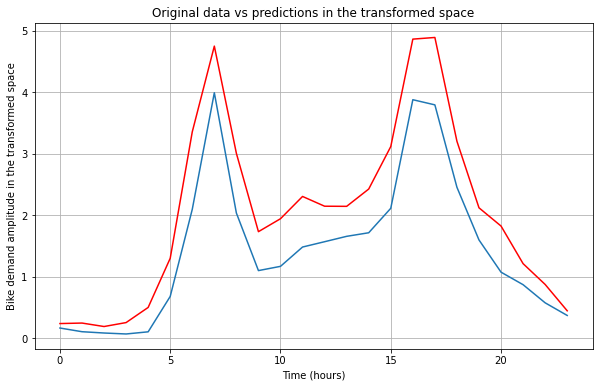

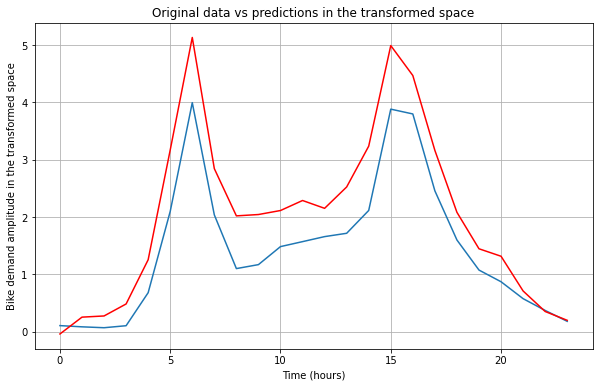

In [98]:
for i in range(0,24):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

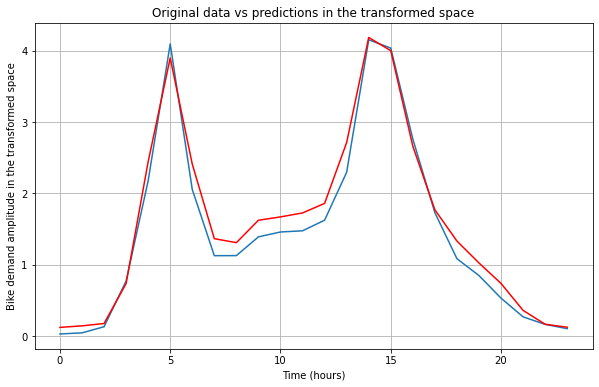

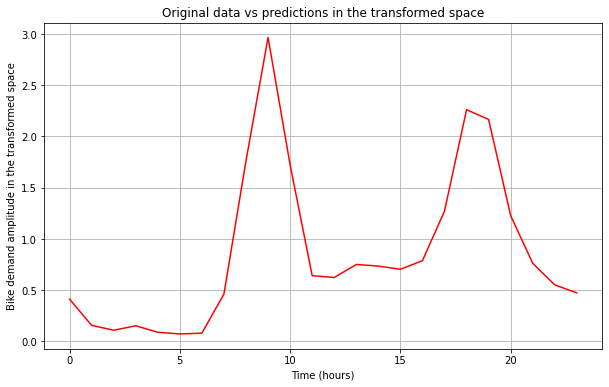

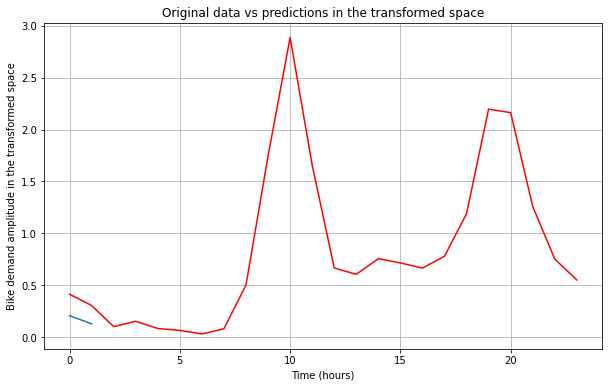

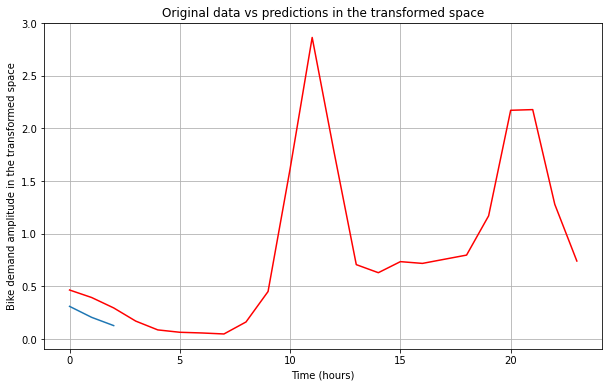

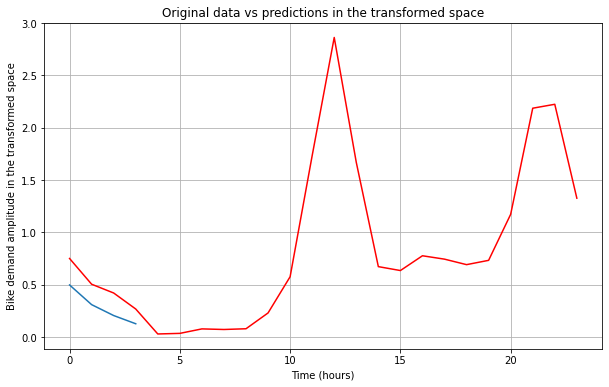

...

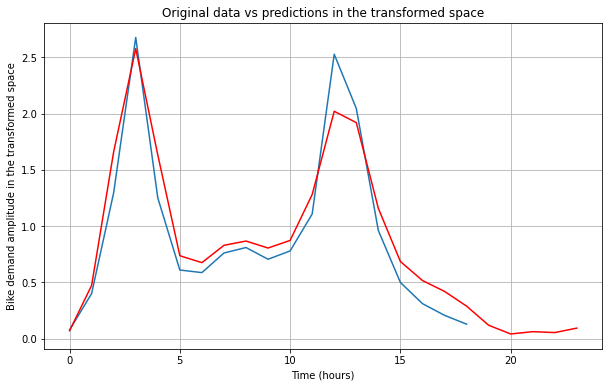

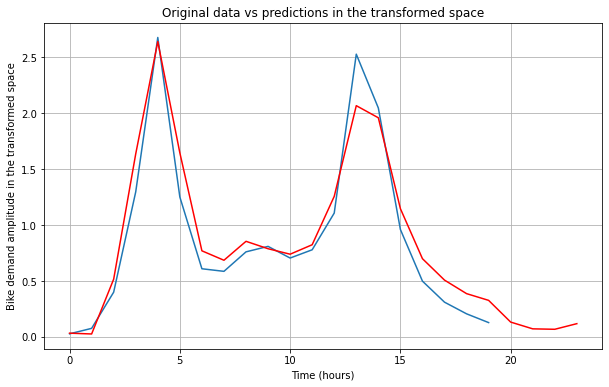

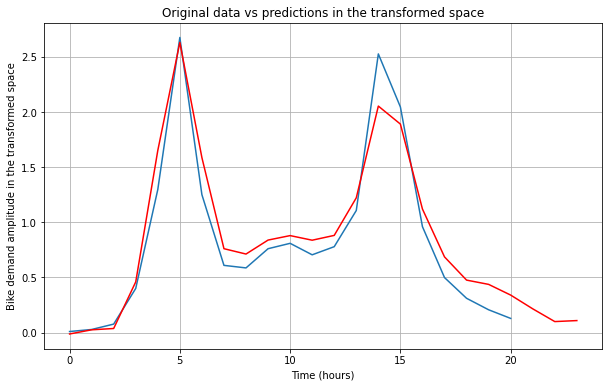

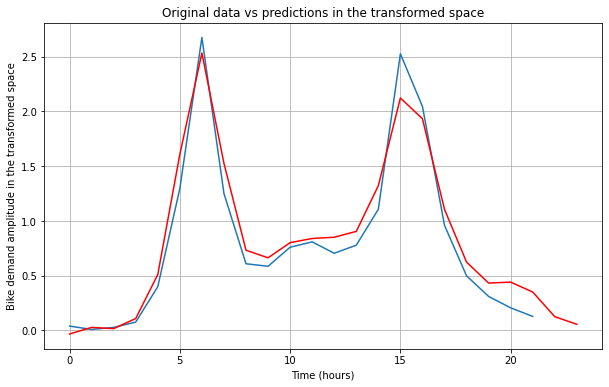

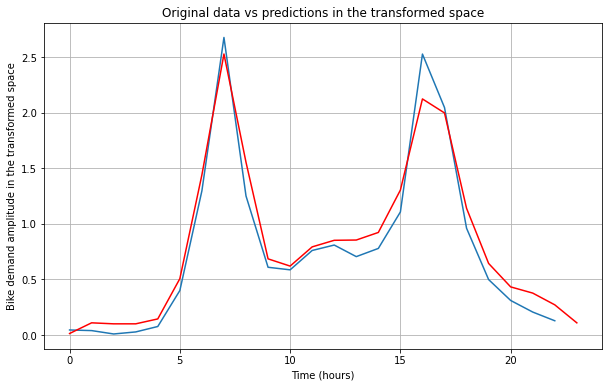

In [ ]:
for i in range(0,24):
  the_hour = -i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [99]:
def multistep_LSTM_2():

  # The LSTM architecture
  model = Sequential()
  # First LSTM layer with Dropout regularisation
  model.add(LSTM(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1])))
  model.add(Dropout(0.6))
  # Second LSTM layer
  #model.add(LSTM(units=50, return_sequences=True))
  #model.add(Dropout(0.2))
  # Third LSTM layer
  #model.add(LSTM(units=50, return_sequences=True))
  #model.add(Dropout(0.6))
  # Fourth LSTM layer
  model.add(LSTM(units=50))
  model.add(Dropout(0.4))
  # The output layer
  model.add(Dense(time_step))
  return model

In [100]:
LSTM_drop2 = multistep_LSTM_2()

In [101]:
LSTM_drop2.summary()
LSTM_drop2.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 48, 50)            12400     
                                                                 
 dropout_3 (Dropout)         (None, 48, 50)            0         
                                                                 
 lstm_5 (LSTM)               (None, 50)                20200     
                                                                 
 dropout_4 (Dropout)         (None, 50)                0         
                                                                 
 dense_2 (Dense)             (None, 24)                1224      
                                                                 
Total params: 33,824
Trainable params: 33,824
Non-trainable params: 0
_________________________________________________________________


In [102]:
history_LSTM_drop2 = LSTM_drop2.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=35)

Epoch 1/25
357/357 [==============================] - 25s 61ms/step - loss: 0.7571 - mse: 0.7571 - val_loss: 0.6170 - val_mse: 0.6170
Epoch 2/25
357/357 [==============================] - 21s 58ms/step - loss: 0.4733 - mse: 0.4733 - val_loss: 0.3951 - val_mse: 0.3951
Epoch 3/25
357/357 [==============================] - 23s 64ms/step - loss: 0.3863 - mse: 0.3863 - val_loss: 0.3682 - val_mse: 0.3682
Epoch 4/25
357/357 [==============================] - 21s 58ms/step - loss: 0.3536 - mse: 0.3536 - val_loss: 0.3245 - val_mse: 0.3245
Epoch 5/25
357/357 [==============================] - 21s 58ms/step - loss: 0.3275 - mse: 0.3275 - val_loss: 0.2930 - val_mse: 0.2930
Epoch 6/25
357/357 [==============================] - 21s 58ms/step - loss: 0.3044 - mse: 0.3044 - val_loss: 0.2772 - val_mse: 0.2772
Epoch 7/25
357/357 [==============================] - 23s 63ms/step - loss: 0.2864 - mse: 0.2864 - val_loss: 0.2623 - val_mse: 0.2623
Epoch 8/25
357/357 [==============================] - 22s 61ms

In [121]:
LSTM_drop2.save('LSTM_drop2.h5')

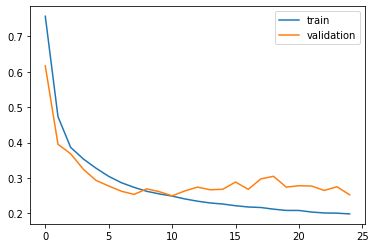

In [106]:
plt.plot(history_LSTM_drop2.history['loss'], label='train')
plt.plot(history_LSTM_drop2.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [103]:
y_pred = LSTM_drop2.predict(X_test)

print(y_pred.shape)
print(y_test.shape)
print(y_pred_.shape)
print(y_test_.shape)

(3483, 24)
(3483, 24)
(3460, 24)
(3460, 24)


In [104]:
y_pred_ = y_pred[0:-23,:]
y_test_ = y_test[0:-23,:]

In [107]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.44785610242381074
Train RMSE: 0.4455824441401732
Train RMSE: 0.4593298961673073
Train RMSE: 0.46046489853708666
Train RMSE: 0.46657357964799434
Train RMSE: 0.46976370797353495
Train RMSE: 0.4844477060513159
Train RMSE: 0.47814179598013573
Train RMSE: 0.48818505311974686
Train RMSE: 0.4885766786667594
Train RMSE: 0.4981707492687343
Train RMSE: 0.4931353117481809
Train RMSE: 0.4947001135354995
Train RMSE: 0.4945427629178555
Train RMSE: 0.4914067240440103
Train RMSE: 0.48987670360245317
Train RMSE: 0.49522353198463653
Train RMSE: 0.4939552644778196
Train RMSE: 0.49620074268235315
Train RMSE: 0.5013388962790435
Train RMSE: 0.5088002190989253
Train RMSE: 0.5153259627810837
Train RMSE: 0.5161356443469256
Train RMSE: 0.5275486461601975


In [108]:
for i in range(len(y_pred[0,:])):
  print('Explained variance score:', explained_variance_score(y_test_[:,i], y_pred_[:,i]))

Explained variance score: 0.8159058180524226
Explained variance score: 0.8175798293992913
Explained variance score: 0.8065003976462725
Explained variance score: 0.8053352704072335
Explained variance score: 0.8005407976322982
Explained variance score: 0.7984975744041078
Explained variance score: 0.7853600141019461
Explained variance score: 0.7902875402545041
Explained variance score: 0.7819865353465788
Explained variance score: 0.7814470319807891
Explained variance score: 0.7720732296082591
Explained variance score: 0.7761173461688154
Explained variance score: 0.7741263148051827
Explained variance score: 0.7741469000190905
Explained variance score: 0.7769189478451572
Explained variance score: 0.7777395605816876
Explained variance score: 0.7723326771056533
Explained variance score: 0.7734661695058682
Explained variance score: 0.7714218334430532
Explained variance score: 0.7667168571811276
Explained variance score: 0.7598917852244114
Explained variance score: 0.7535519913752897
Explained 

In [109]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(max_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 1.6876802355037062
Train RMSE: 1.7057295323108614
Train RMSE: 1.7757400829928296
Train RMSE: 1.7651457015940084
Train RMSE: 1.7645372743313037
Train RMSE: 1.7778222756340154
Train RMSE: 1.8159772475202771
Train RMSE: 1.827140005408072
Train RMSE: 1.842506555759679
Train RMSE: 1.9040416689511617
Train RMSE: 1.919870432767794
Train RMSE: 1.9090665121449393
Train RMSE: 1.8857524132896455
Train RMSE: 1.8929077119495872
Train RMSE: 1.883460919150502
Train RMSE: 1.894089040192272
Train RMSE: 1.9001012668268635
Train RMSE: 1.8950247845544375
Train RMSE: 1.9449745258235176
Train RMSE: 1.9726394054135705
Train RMSE: 1.9653073446666869
Train RMSE: 1.9347859884088252
Train RMSE: 1.9952765960969472
Train RMSE: 2.026525755612767


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

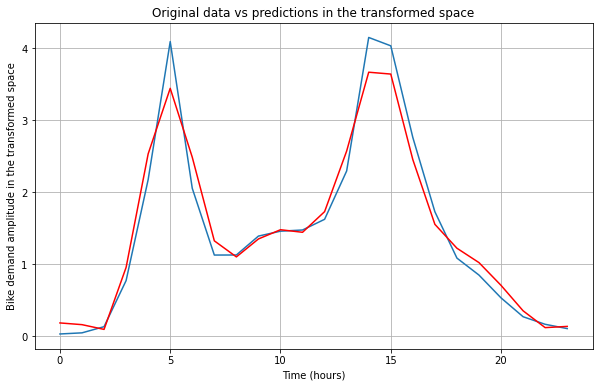

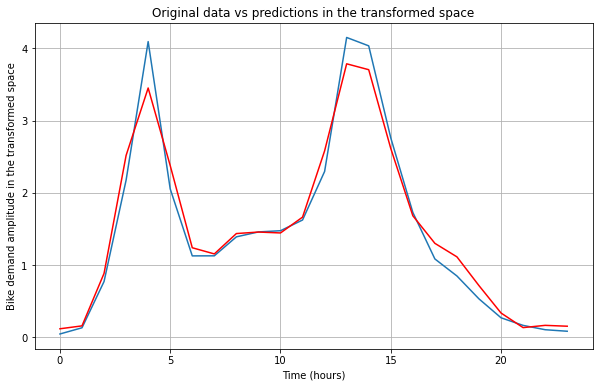

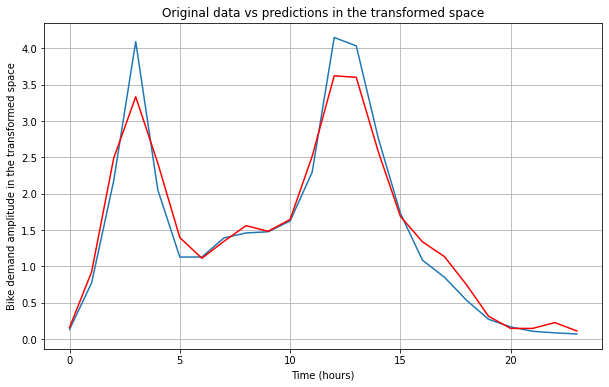

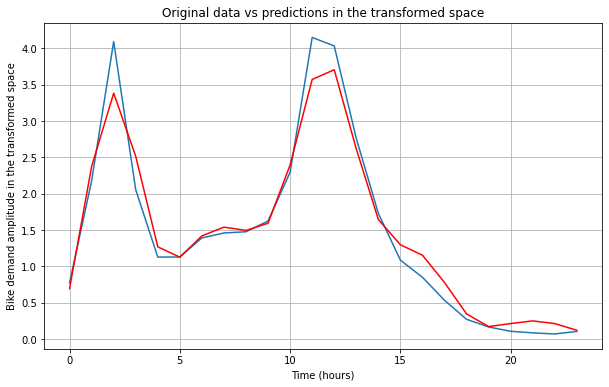

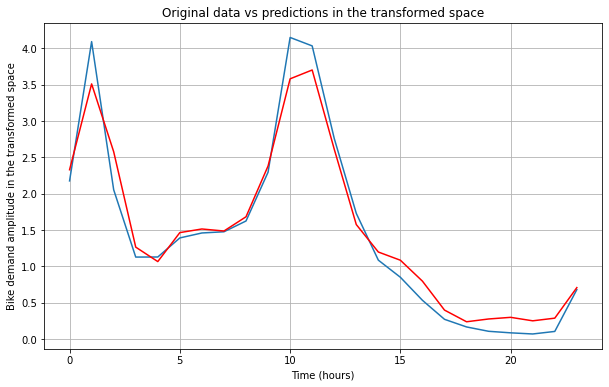

...

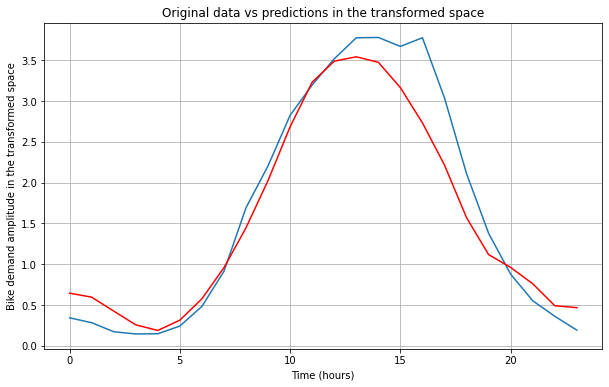

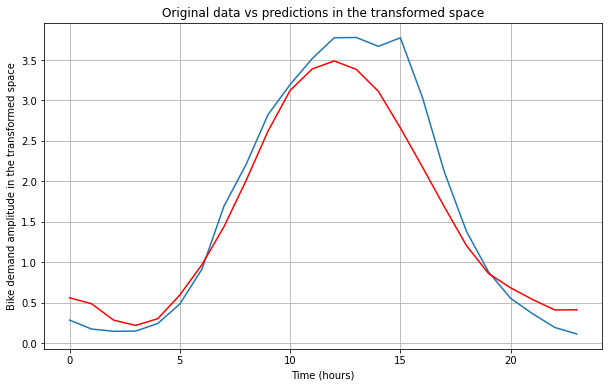

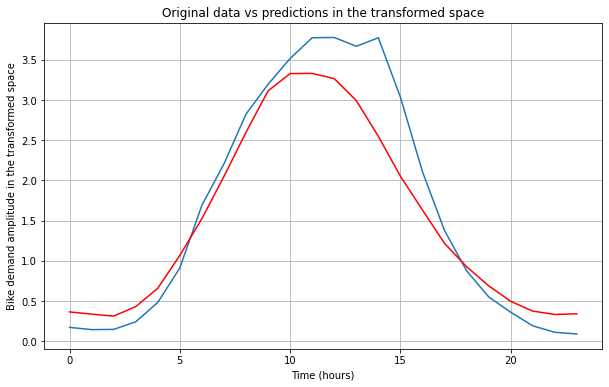

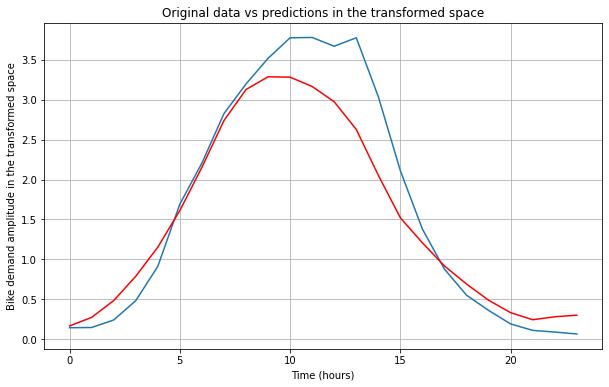

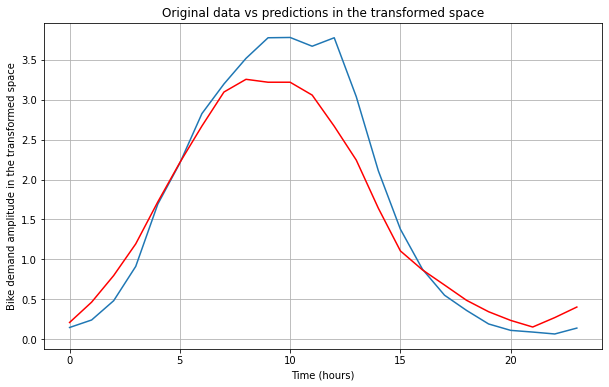

In [111]:
for i in range(0,100):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

# GRU

In [ ]:
time_step

24

In [ ]:
def GRU():
  model= Sequential()
  model.add(GRU(units = 64, input_shape=(lookback, X_train.shape[-1])))
  model.add(Dense(units = 64, activation = 'relu'))
  model.add(Dropout(0.2))
  #model.add(GRU(units = 64))
  #model.add(Dropout(0.2))
  model.add(Dense(units = time_step))
  
  return model

In [ ]:
from keras.layers import GRU

In [ ]:
model_gru = Sequential()
model_gru.add(GRU(32, input_shape=(lookback, X_train.shape[-1])))
model_gru.add(Dense(units = 512, activation = 'relu'))
model_gru.add(Dropout(0.2))
model_gru.add(Dense(units = time_step, activation = 'linear'))
model_gru.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_1 (GRU)                 (None, 32)                4320      
                                                                 
 dense_2 (Dense)             (None, 512)               16896     
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 24)                12312     
                                                                 
Total params: 33,528
Trainable params: 33,528
Non-trainable params: 0
_________________________________________________________________


In [ ]:
loss = 'mean_squared_error'
optimizer = "adam"

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

In [ ]:
model_gru = GRU()
model_gru.summary()
model_gru.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

import keras.backend as K
print(K.get_value(model_gru.optimizer.lr))

TypeError: ignored

In [ ]:
model_gru.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

#import keras.backend as K
#print(K.get_value(model_gru.optimizer.lr))

In [ ]:
history_model_3 = model_gru.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=32)

Epoch 1/25
391/391 [==============================] - 9s 17ms/step - loss: 0.4784 - mse: 0.4784 - val_loss: 0.3564 - val_mse: 0.3564
Epoch 2/25
391/391 [==============================] - 6s 16ms/step - loss: 0.2524 - mse: 0.2524 - val_loss: 0.2536 - val_mse: 0.2536
Epoch 3/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1969 - mse: 0.1969 - val_loss: 0.2367 - val_mse: 0.2367
Epoch 4/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1738 - mse: 0.1738 - val_loss: 0.2041 - val_mse: 0.2041
Epoch 5/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1595 - mse: 0.1595 - val_loss: 0.2174 - val_mse: 0.2174
Epoch 6/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1505 - mse: 0.1505 - val_loss: 0.1851 - val_mse: 0.1851
Epoch 7/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1444 - mse: 0.1444 - val_loss: 0.1782 - val_mse: 0.1782
Epoch 8/25
391/391 [==============================] - 6s 16ms/step - 

In [ ]:
model_gru.save('model_gru.h5')

In [ ]:
# Prediction
y_pred = model_gru.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_hour = y_pred[the_day,:]


In [ ]:
y_pred.shape

(3483, 24)

In [ ]:
3483/9

387.0

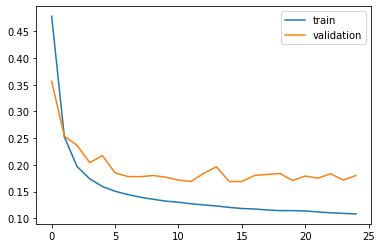

In [ ]:
plt.plot(history_model_3.history['loss'], label='train')
plt.plot(history_model_3.history['val_loss'], label='validation')
plt.legend()
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

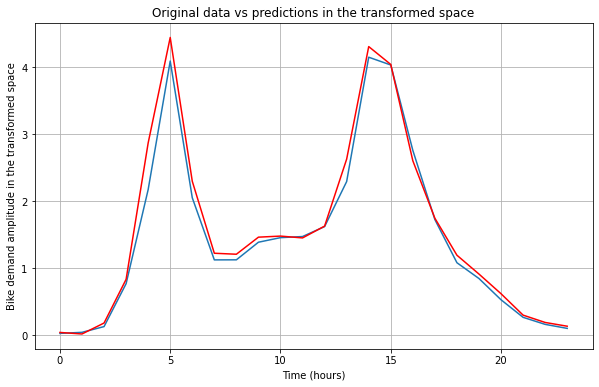

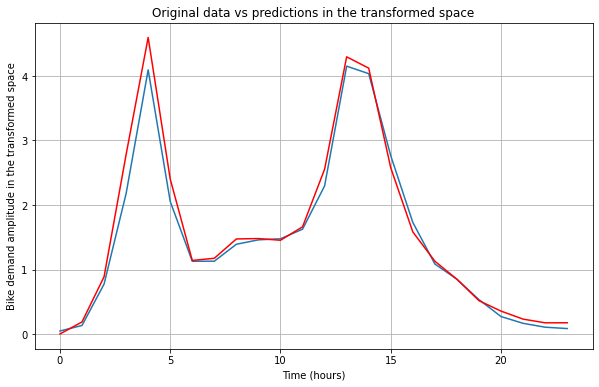

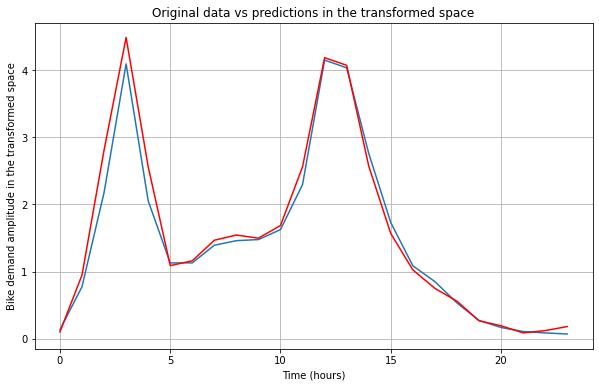

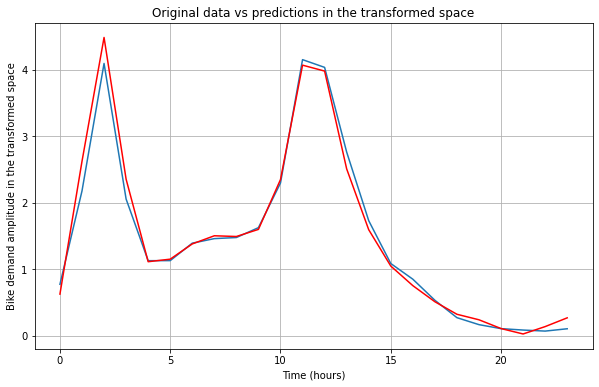

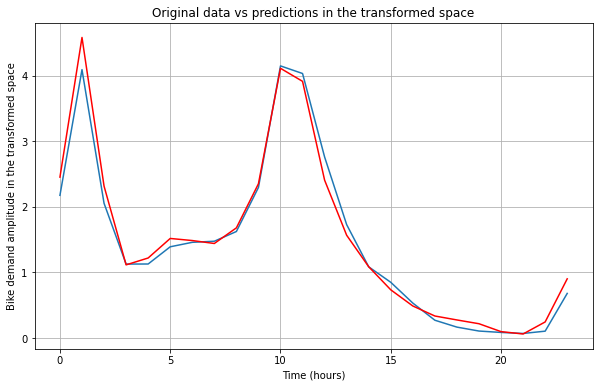

...

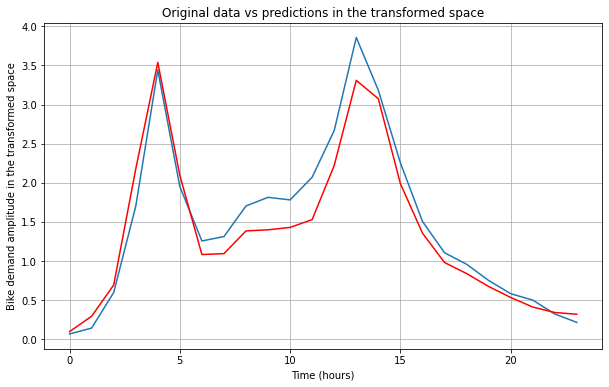

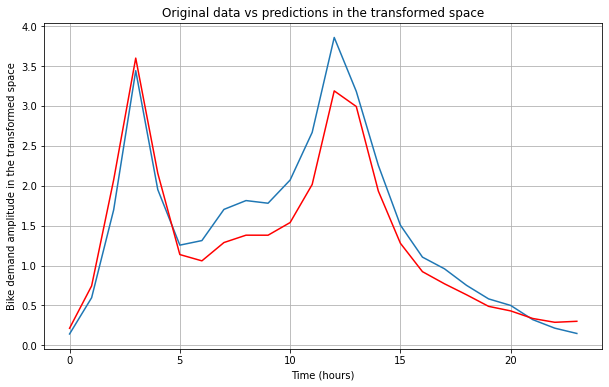

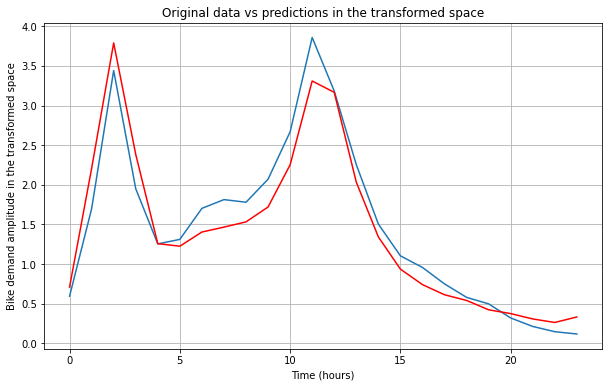

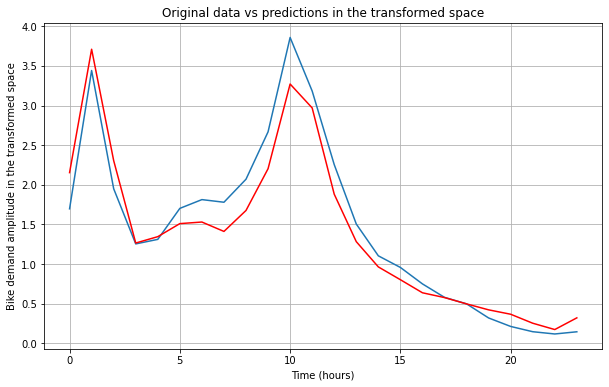

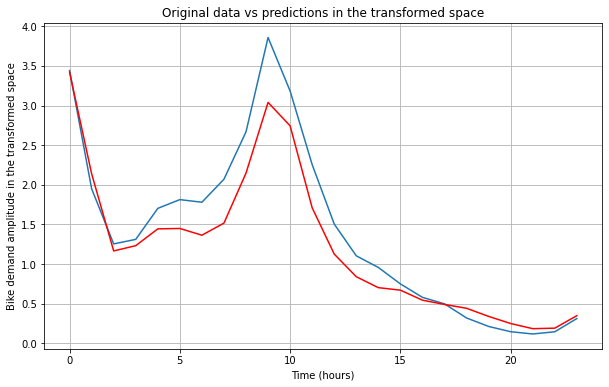

In [ ]:
for i in range(0,387):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [ ]:
y_pred_ = y_pred[0:-23,:]
y_test_ = y_test[0:-23,:]

In [ ]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.1957180921337819
Train RMSE: 0.2702362255760413
Train RMSE: 0.310100402686849
Train RMSE: 0.3338900124234923
Train RMSE: 0.3467488231615142
Train RMSE: 0.3480406598144268
Train RMSE: 0.3535991191043795
Train RMSE: 0.3523480591704542
Train RMSE: 0.3598671365644495
Train RMSE: 0.38446880055456256
Train RMSE: 0.3931271263039456
Train RMSE: 0.39412779998802894
Train RMSE: 0.3937908365010828
Train RMSE: 0.393748888540672
Train RMSE: 0.3941705286583222
Train RMSE: 0.40324840306991516
Train RMSE: 0.4071069956430855
Train RMSE: 0.40368176762915897
Train RMSE: 0.4121903790149053
Train RMSE: 0.4135660159946941
Train RMSE: 0.4171044160854758
Train RMSE: 0.41468184998699087
Train RMSE: 0.42415575676701145
Train RMSE: 0.43335709661285926


Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

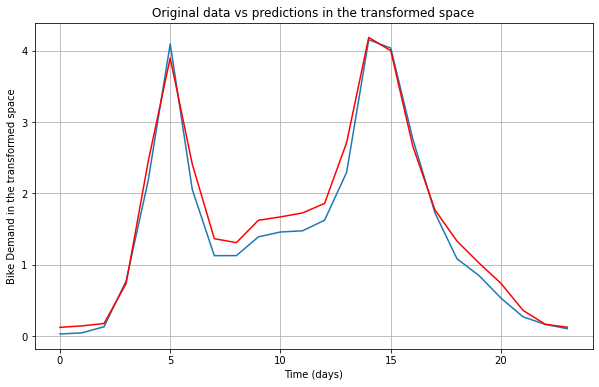

In [ ]:
# Prediction
y_pred = model_2.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (days)')
plt.ylabel('Bike Demand in the transformed space')
plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

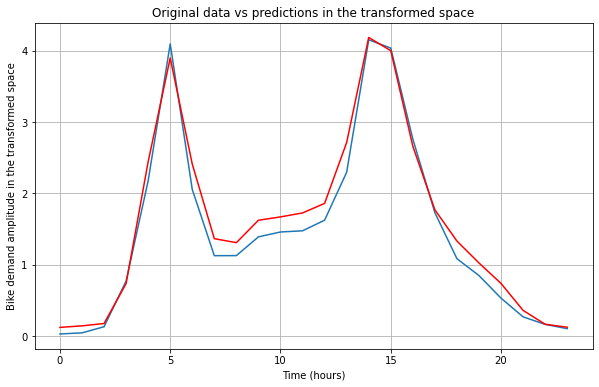

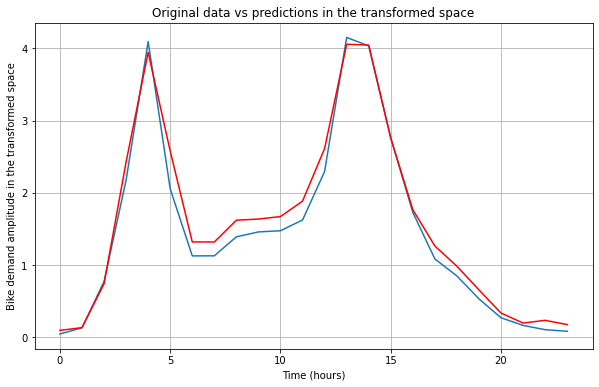

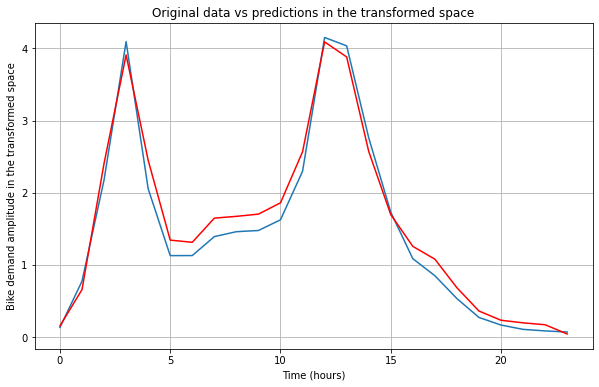

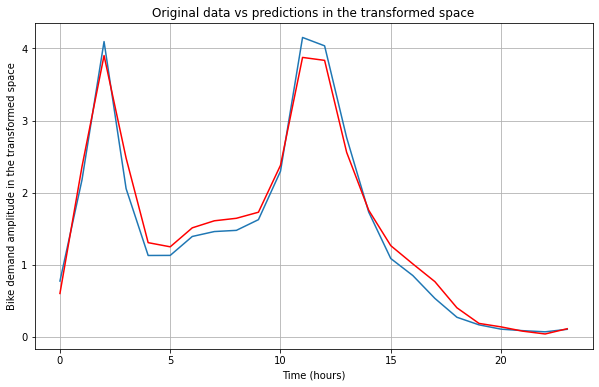

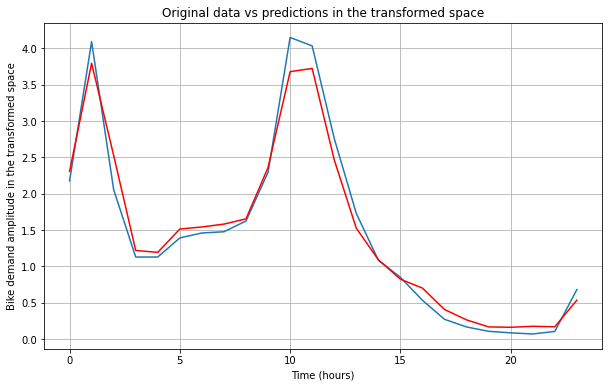

...

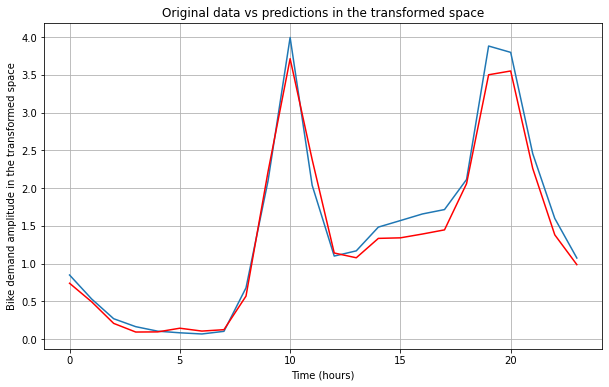

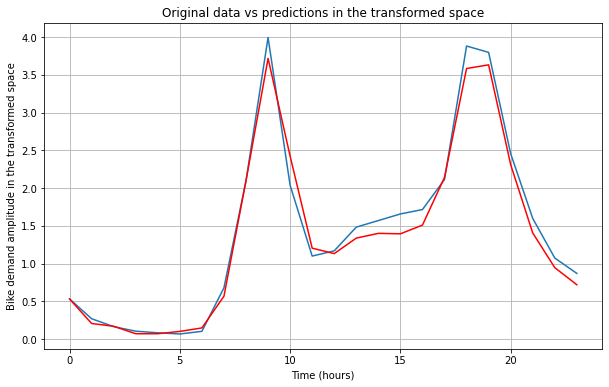

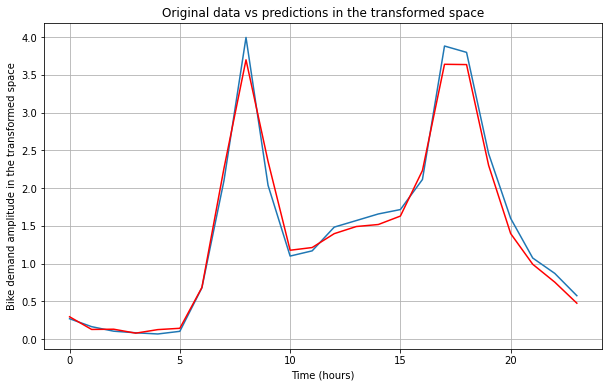

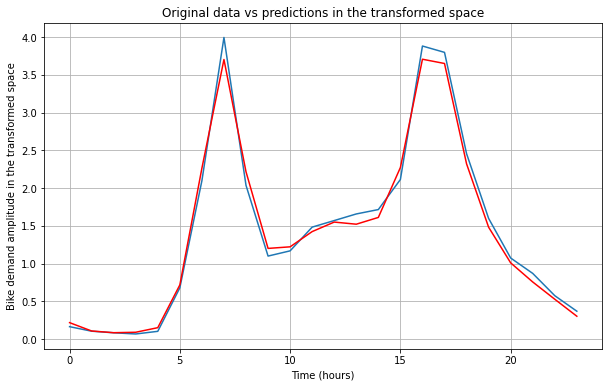

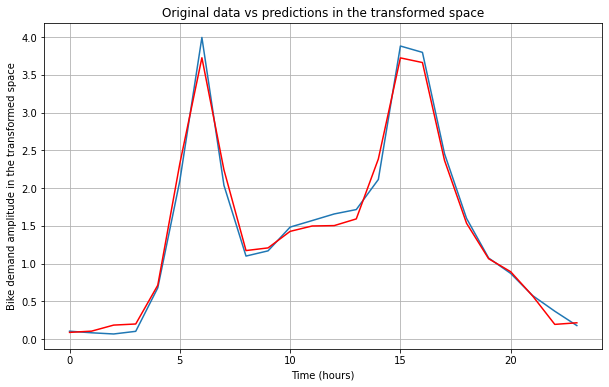

In [ ]:
for i in range(0,24):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

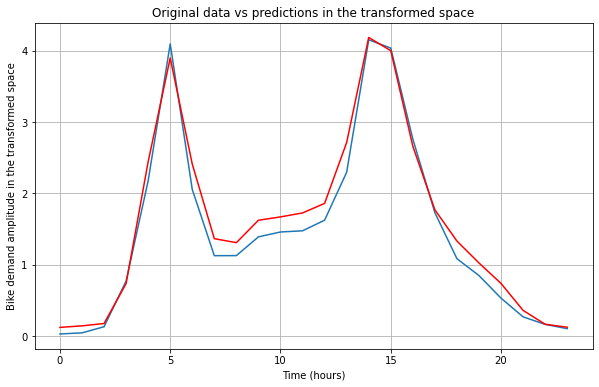

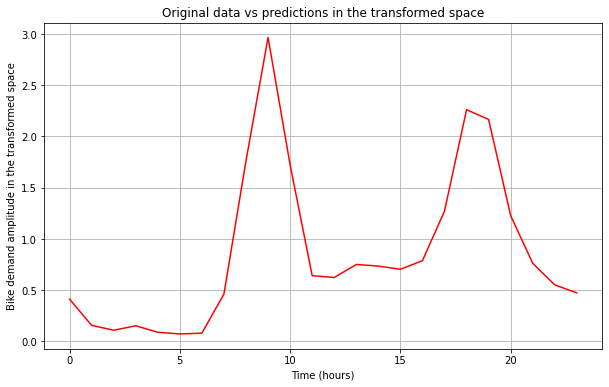

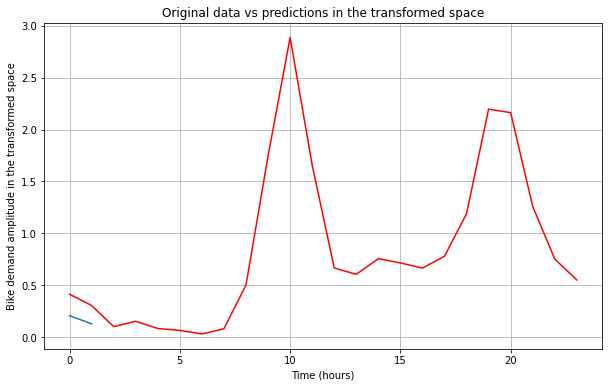

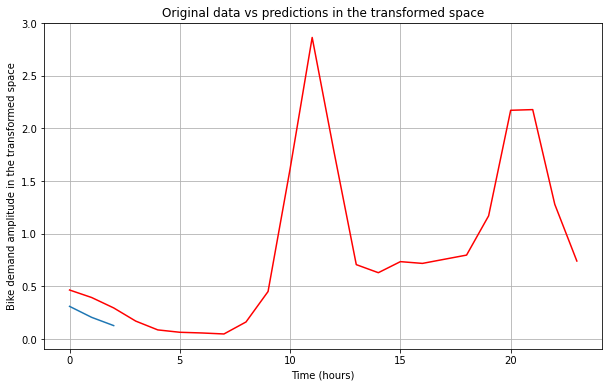

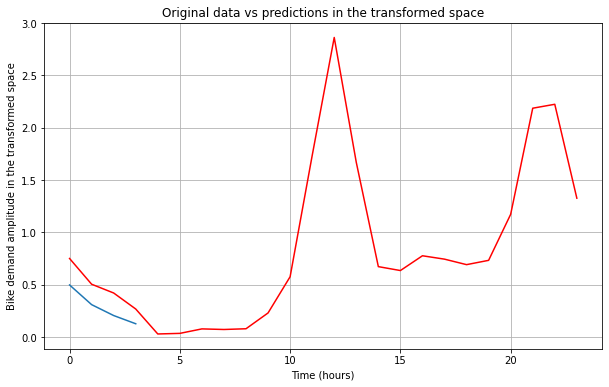

...

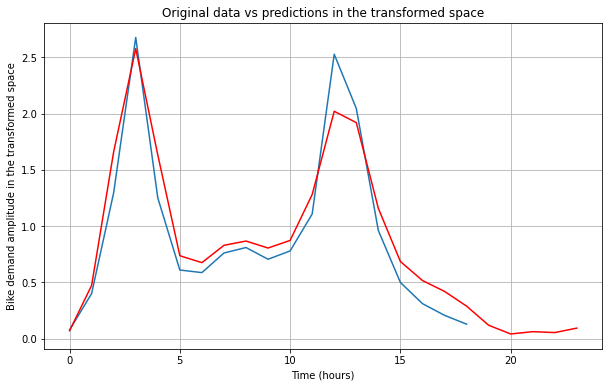

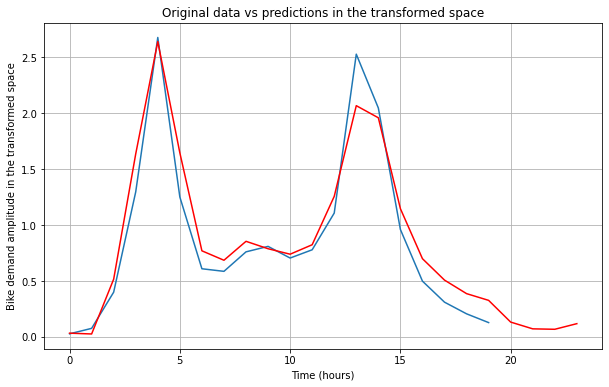

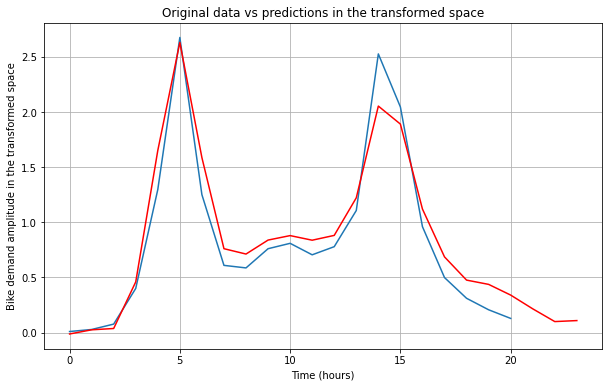

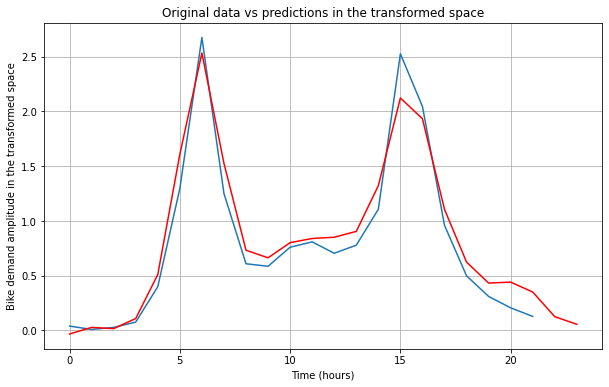

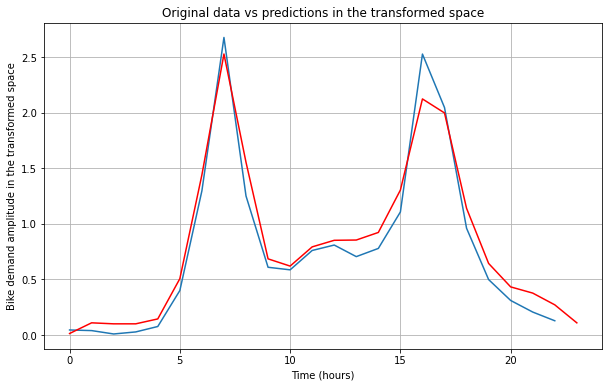

In [ ]:
for i in range(0,24):
  the_hour = -i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [ ]:
sample = X_test[i:(i+1)].copy()

pred0 = model_gru.predict(sample)[0][0]
delta = 1e-3
w_in = sample.shape[1]

print("SENSIBILIDAD DE LA PREDICCIÓN A LAS ENTRADAS:\n")
for i,x in enumerate(nombres_series):
    for j in range(w_in):
        sample_pert = sample.copy()
        sample_pert[0,j,i] += delta
        pred_pert = model.predict(sample_pert)[0][0]
        if se_saben_antes[i]:
            print("{} (t-{}) [ADELANTADA]: {:.3f}".format(x, w_in-j, (pred_pert - pred0) / delta))
        else:
            print("{} (t-{}): {:.3f}".format(x, w_in-j, (pred_pert - pred0) / delta))

SENSIBILIDAD DE LA PREDICCIÓN A LAS ENTRADAS:



TypeError: ignored

# CNN-LSTM


In [ ]:
# The GRU architecture
regressorGRU = Sequential()
# First GRU layer with Dropout regularisation
regressorGRU.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU.add(Dropout(0.2))
# Second GRU layer
regressorGRU.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU.add(Dropout(0.2))
# Third GRU layer
regressorGRU.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU.add(Dropout(0.2))
# Fourth GRU layer
regressorGRU.add(GRU(units=50, activation='tanh'))
regressorGRU.add(Dropout(0.2))
# The output layer
regressorGRU.add(Dense(units=time_step))
# Compiling the RNN
regressorGRU.compile(optimizer=optimizer,
                     loss=loss,
                     metrics=['mse'])
# Fitting to the training set
history_regressorGRU = regressorGRU.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=32)

Epoch 1/25
391/391 [==============================] - 38s 76ms/step - loss: 0.6440 - mse: 0.6440 - val_loss: 0.4882 - val_mse: 0.4882
Epoch 2/25
391/391 [==============================] - 28s 72ms/step - loss: 0.3742 - mse: 0.3742 - val_loss: 0.3259 - val_mse: 0.3259
Epoch 3/25
391/391 [==============================] - 29s 73ms/step - loss: 0.2998 - mse: 0.2998 - val_loss: 0.2842 - val_mse: 0.2842
Epoch 4/25
391/391 [==============================] - 28s 72ms/step - loss: 0.2583 - mse: 0.2583 - val_loss: 0.2530 - val_mse: 0.2530
Epoch 5/25
391/391 [==============================] - 28s 73ms/step - loss: 0.2380 - mse: 0.2380 - val_loss: 0.2418 - val_mse: 0.2418
Epoch 6/25
391/391 [==============================] - 28s 73ms/step - loss: 0.2223 - mse: 0.2223 - val_loss: 0.2224 - val_mse: 0.2224
Epoch 7/25
391/391 [==============================] - 29s 74ms/step - loss: 0.2081 - mse: 0.2081 - val_loss: 0.2178 - val_mse: 0.2178
Epoch 8/25
391/391 [==============================] - 28s 73ms

In [ ]:
regressorGRU.save('regressorGRU.h5')

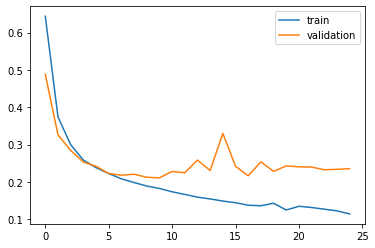

In [ ]:
plt.plot(history_regressorGRU.history['loss'], label='train')
plt.plot(history_regressorGRU.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [ ]:
y_pred_regressor_gru = regressorGRU.predict(X_test)

y_pred_ = y_pred_regressor_gru [0:-23,:]
y_test_ = y_test[0:-23,:]

for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.4042688295602386
Train RMSE: 0.4177704903729347
Train RMSE: 0.4231894971507141
Train RMSE: 0.43247347417901033
Train RMSE: 0.43774150708553927
Train RMSE: 0.4427674410211132
Train RMSE: 0.45103773093569105
Train RMSE: 0.4540172570750616
Train RMSE: 0.4613863054862458
Train RMSE: 0.46614344357847404
Train RMSE: 0.47304379515302597
Train RMSE: 0.4795461469052225
Train RMSE: 0.48040224220298805
Train RMSE: 0.4815892418017644
Train RMSE: 0.479683597330578
Train RMSE: 0.4848894739253106
Train RMSE: 0.48725593702720577
Train RMSE: 0.4945872300440677
Train RMSE: 0.49371615136178293
Train RMSE: 0.48872351170650163
Train RMSE: 0.48653525448633367
Train RMSE: 0.4876443013191766
Train RMSE: 0.4858908053613041
Train RMSE: 0.4907425214981193


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

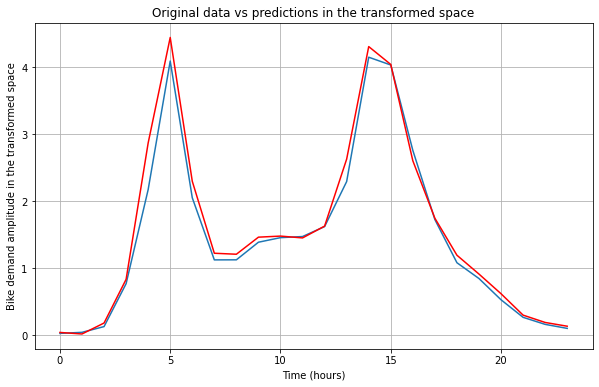

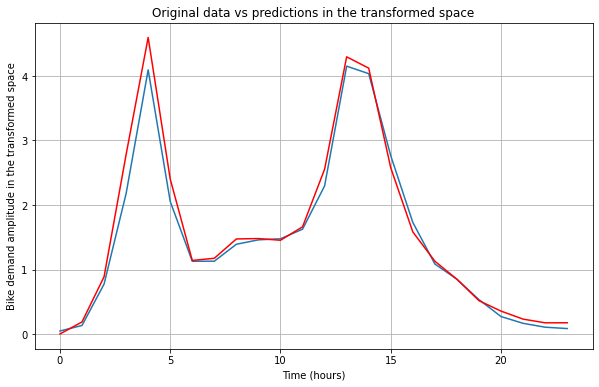

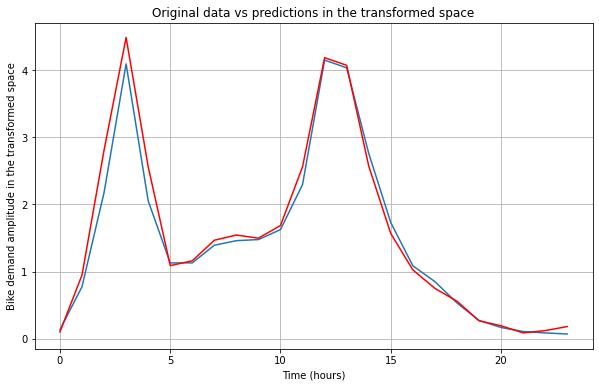

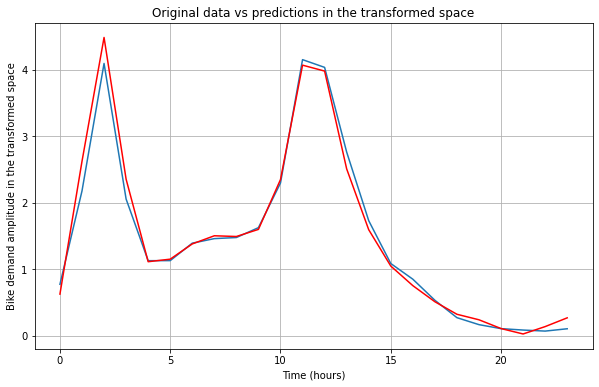

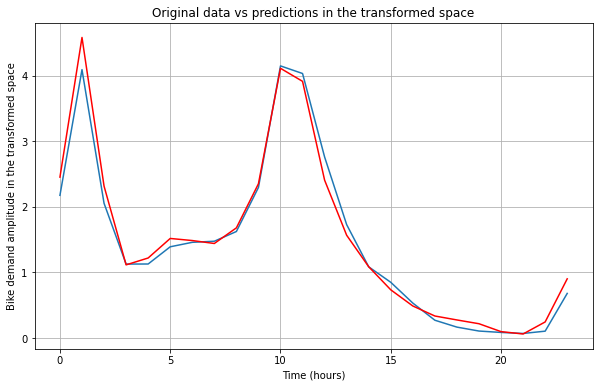

...

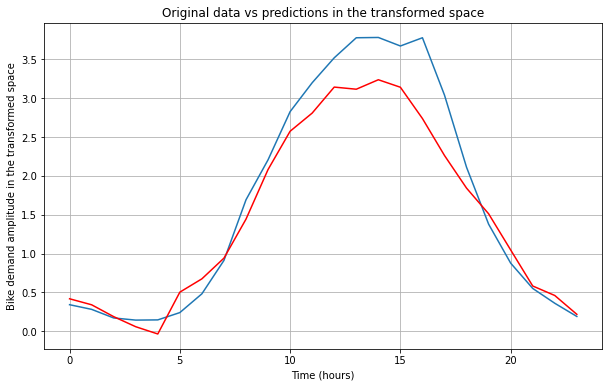

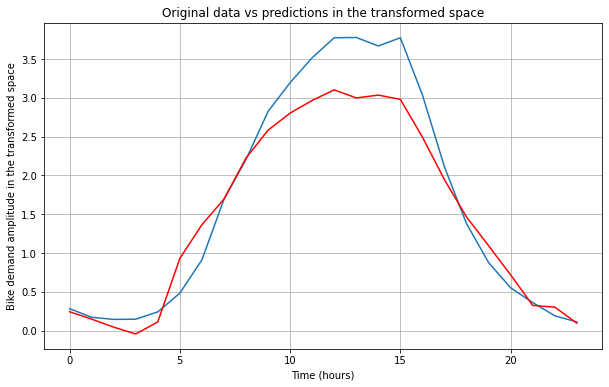

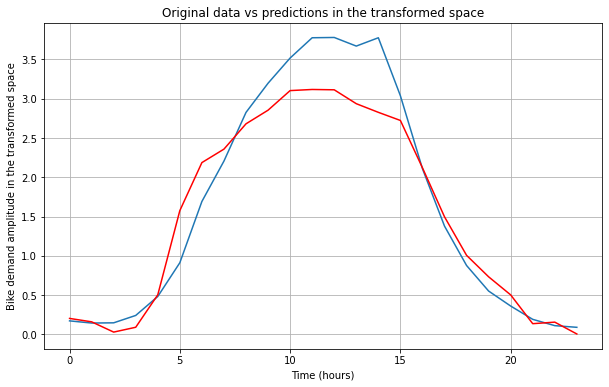

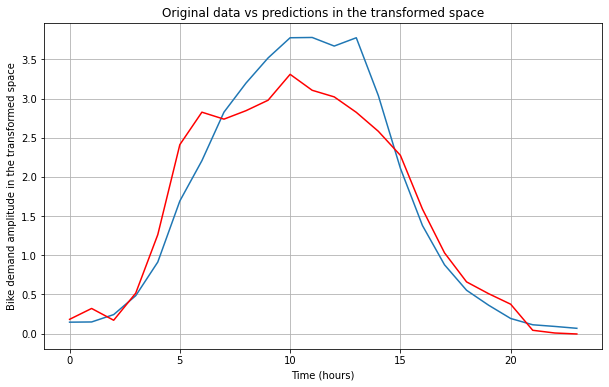

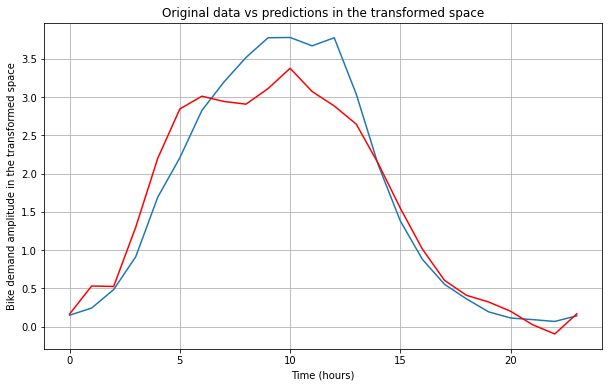

In [ ]:
for i in range(0,100):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [ ]:
from sklearn.metrics import mean_squared_error, explained_variance_score, max_error

In [ ]:
for i in range(len(y_pred[0,:])):
  print('Explained variance score:', explained_variance_score(y_test_[:,i], y_pred_[:,i]))

Explained variance score: 0.8560137625937232
Explained variance score: 0.8439802378744219
Explained variance score: 0.838779781166932
Explained variance score: 0.8312677778952116
Explained variance score: 0.8271865232457938
Explained variance score: 0.8212109764492654
Explained variance score: 0.8139066702779624
Explained variance score: 0.8104467587250713
Explained variance score: 0.8038163620612748
Explained variance score: 0.7994480614302122
Explained variance score: 0.7940172880729786
Explained variance score: 0.7886854065831329
Explained variance score: 0.7873845858668476
Explained variance score: 0.7866962815944043
Explained variance score: 0.7878819232222287
Explained variance score: 0.782289682084579
Explained variance score: 0.7796179749862762
Explained variance score: 0.7729024639540223
Explained variance score: 0.7737676696053831
Explained variance score: 0.7783666529343519
Explained variance score: 0.781352049740407
Explained variance score: 0.781521676936477
Explained vari

In [ ]:
# The GRU architecture
regressorGRU_2 = Sequential()
# First GRU layer with Dropout regularisation
regressorGRU_2.add(GRU(units=65, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU_2.add(Dropout(0.2))
# Second GRU layer
regressorGRU_2.add(GRU(units=65, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU_2.add(Dropout(0.3))
# Third GRU layer
regressorGRU_2.add(GRU(units=65, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU_2.add(Dropout(0.3))
# Fourth GRU layer
regressorGRU_2.add(GRU(units=65, activation='tanh'))
regressorGRU_2.add(Dropout(0.3))
# The output layer
regressorGRU_2.add(Dense(units=time_step))
# Compiling the RNN
regressorGRU_2.compile(optimizer=optimizer,
                     loss=loss,
                     metrics=['mse'])
# Fitting to the training set
history_regressorGRU_2 = regressorGRU_2.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=32)

Epoch 1/25
391/391 [==============================] - 43s 91ms/step - loss: 0.6282 - mse: 0.6282 - val_loss: 0.5109 - val_mse: 0.5109
Epoch 2/25
391/391 [==============================] - 34s 87ms/step - loss: 0.3869 - mse: 0.3869 - val_loss: 0.3381 - val_mse: 0.3381
Epoch 3/25
391/391 [==============================] - 36s 93ms/step - loss: 0.3081 - mse: 0.3081 - val_loss: 0.2685 - val_mse: 0.2685
Epoch 4/25
391/391 [==============================] - 35s 89ms/step - loss: 0.2661 - mse: 0.2661 - val_loss: 0.2519 - val_mse: 0.2519
Epoch 5/25
391/391 [==============================] - 38s 96ms/step - loss: 0.2471 - mse: 0.2471 - val_loss: 0.2361 - val_mse: 0.2361
Epoch 6/25
391/391 [==============================] - 35s 90ms/step - loss: 0.2299 - mse: 0.2299 - val_loss: 0.2467 - val_mse: 0.2467
Epoch 7/25
391/391 [==============================] - 34s 88ms/step - loss: 0.2201 - mse: 0.2201 - val_loss: 0.2243 - val_mse: 0.2243
Epoch 8/25
391/391 [==============================] - 34s 87ms

In [ ]:
regressorGRU_2.save('regressorGRU_2.h5')

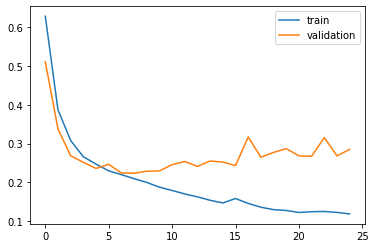

In [ ]:
plt.plot(history_regressorGRU_2.history['loss'], label='train')
plt.plot(history_regressorGRU_2.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [ ]:
y_pred_regressor_gru_2 = regressorGRU_2.predict(X_test)

y_pred_ = y_pred_regressor_gru_2[0:-23,:]
y_test_ = y_test[0:-23,:]

for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.4066038027707877
Train RMSE: 0.42391103978711153
Train RMSE: 0.43515239072325246
Train RMSE: 0.44295246614600914
Train RMSE: 0.4485331839343389
Train RMSE: 0.4528275140852516
Train RMSE: 0.4603805627915513
Train RMSE: 0.4661552674020319
Train RMSE: 0.4738977267121128
Train RMSE: 0.4756236354832584
Train RMSE: 0.4829209177484093
Train RMSE: 0.486881176024241
Train RMSE: 0.4875995682341641
Train RMSE: 0.4842667940211117
Train RMSE: 0.4867855001916986
Train RMSE: 0.49288789642590647
Train RMSE: 0.49395408334639407
Train RMSE: 0.49592511486491314
Train RMSE: 0.4986187585675382
Train RMSE: 0.49984306571326
Train RMSE: 0.49400348445051495
Train RMSE: 0.4935053761547601
Train RMSE: 0.4949424382879406
Train RMSE: 0.5033709655119094


In [ ]:
for i in range(len(y_pred[0,:])):
  print('Explained variance score:', explained_variance_score(y_test_[:,i], y_pred_[:,i]))

Explained variance score: 0.8485802899416934
Explained variance score: 0.8351449848106901
Explained variance score: 0.8263912087615797
Explained variance score: 0.8202468456431119
Explained variance score: 0.8166523886338212
Explained variance score: 0.8135646638578168
Explained variance score: 0.8066154395386416
Explained variance score: 0.8011226088505252
Explained variance score: 0.7947964505815708
Explained variance score: 0.7926062640365976
Explained variance score: 0.7860231506807496
Explained variance score: 0.7829448539627621
Explained variance score: 0.7817941959067133
Explained variance score: 0.784867250353558
Explained variance score: 0.78250520002717
Explained variance score: 0.7772443387700565
Explained variance score: 0.775976607068105
Explained variance score: 0.7748582088270848
Explained variance score: 0.773340244310134
Explained variance score: 0.7734119486707869
Explained variance score: 0.7777488156560516
Explained variance score: 0.7776306585444517
Explained varia

In [76]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(max_error(y_test_[:,i], y_pred_[:,i])))

NameError: ignored

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

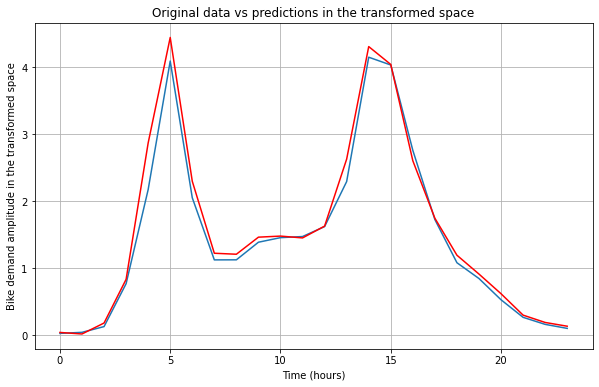

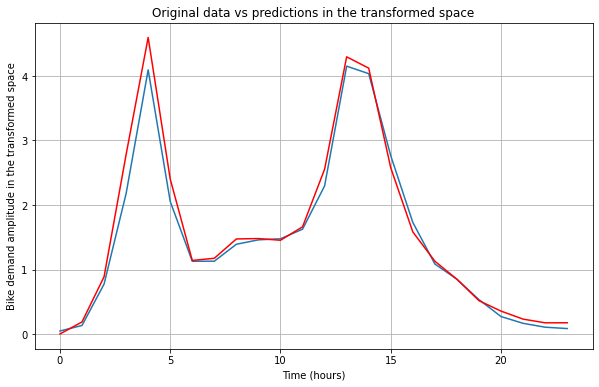

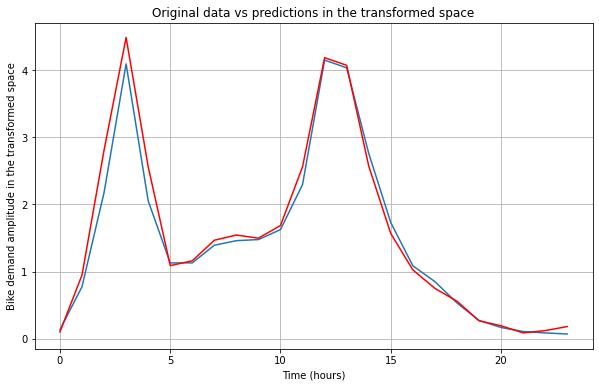

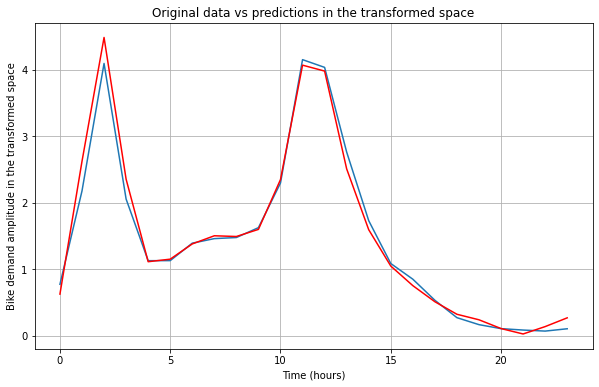

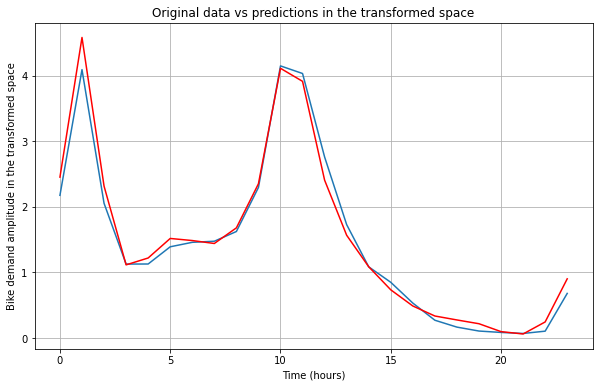

...

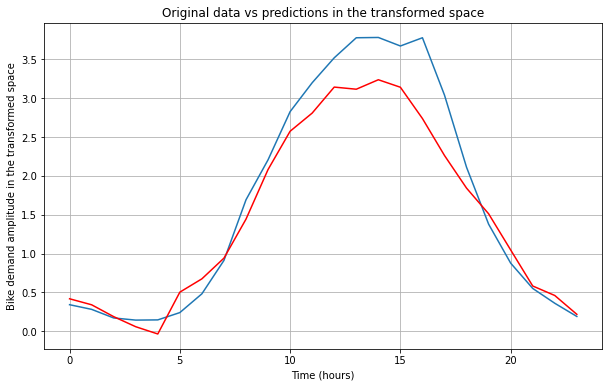

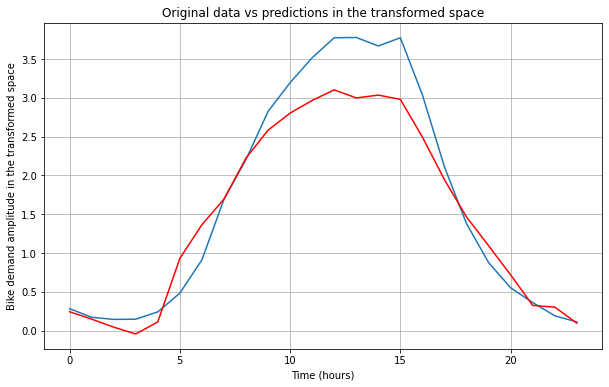

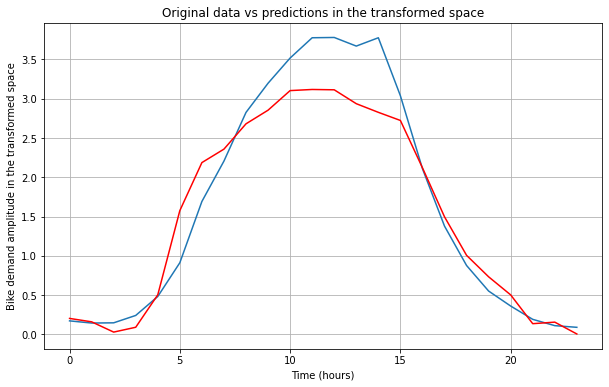

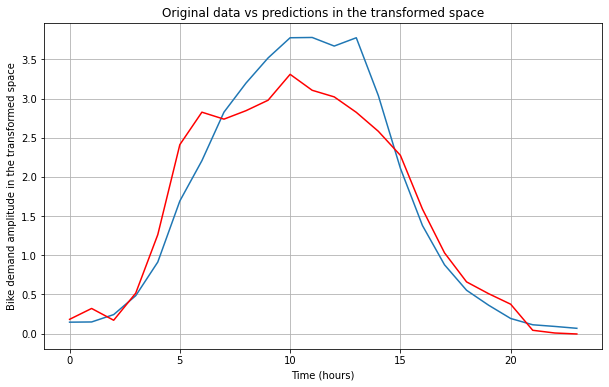

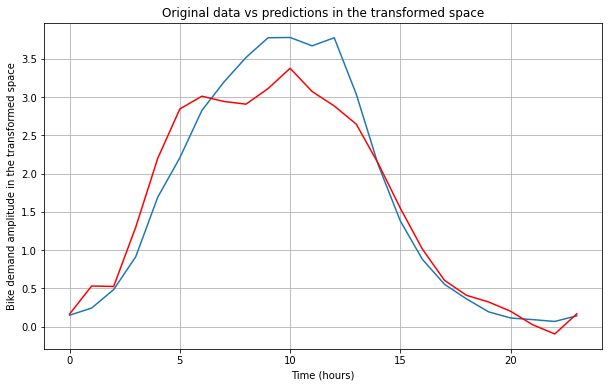

In [ ]:
for i in range(0,100):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [119]:
# The GRU architecture
regressorGRU_drop = Sequential()
# First GRU layer with Dropout regularisation
regressorGRU_drop.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU_drop.add(Dropout(0.2))
# Second GRU layer
regressorGRU_drop.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU_drop.add(Dropout(0.6))
# Third GRU layer
regressorGRU_drop.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU_drop.add(Dropout(0.6))
# Fourth GRU layer
regressorGRU_drop.add(GRU(units=50, activation='tanh'))
regressorGRU_drop.add(Dropout(0.2))
# The output layer
regressorGRU_drop.add(Dense(units=time_step))
# Compiling the RNN
regressorGRU_drop.compile(optimizer='adam',
                     loss=loss,
                     metrics=['mse'])
# Fitting to the training set
history_regressorGRU = regressorGRU_drop.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=32)

Epoch 1/25
391/391 [==============================] - 62s 126ms/step - loss: 0.7011 - mse: 0.7011 - val_loss: 0.6267 - val_mse: 0.6267
Epoch 2/25
391/391 [==============================] - 47s 121ms/step - loss: 0.4847 - mse: 0.4847 - val_loss: 0.4783 - val_mse: 0.4783
Epoch 3/25
391/391 [==============================] - 47s 120ms/step - loss: 0.3777 - mse: 0.3777 - val_loss: 0.3614 - val_mse: 0.3614
Epoch 4/25
391/391 [==============================] - 47s 120ms/step - loss: 0.3230 - mse: 0.3230 - val_loss: 0.3152 - val_mse: 0.3152
Epoch 5/25
391/391 [==============================] - 47s 121ms/step - loss: 0.2835 - mse: 0.2835 - val_loss: 0.2711 - val_mse: 0.2711
Epoch 6/25
391/391 [==============================] - 46s 118ms/step - loss: 0.2550 - mse: 0.2550 - val_loss: 0.2781 - val_mse: 0.2781
Epoch 7/25
391/391 [==============================] - 47s 119ms/step - loss: 0.2417 - mse: 0.2417 - val_loss: 0.2728 - val_mse: 0.2728
Epoch 8/25
391/391 [==============================] - 4

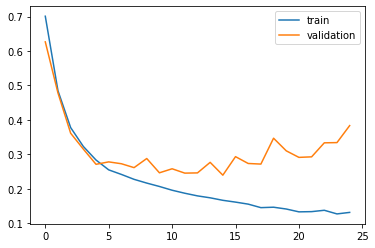

In [122]:
plt.plot(history_regressorGRU.history['loss'], label='train')
plt.plot(history_regressorGRU.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [123]:
# Prediction
y_pred = regressorGRU_drop.predict(X_test)

In [124]:
y_pred_ = y_pred[0:-23,:]
y_test_ = y_test[0:-23,:]

for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.4811864386496481
Train RMSE: 0.49184908854096215
Train RMSE: 0.5022391701558788
Train RMSE: 0.5055349753898691
Train RMSE: 0.49652018234744766
Train RMSE: 0.5043593903993332
Train RMSE: 0.5028152365388493
Train RMSE: 0.5007651912960293
Train RMSE: 0.5119455483170694
Train RMSE: 0.5167929464299362
Train RMSE: 0.5159202350319902
Train RMSE: 0.5156298012111481
Train RMSE: 0.5180328716629108
Train RMSE: 0.520428316670418
Train RMSE: 0.5221247467031939
Train RMSE: 0.5247235367157649
Train RMSE: 0.5251867322195601
Train RMSE: 0.5203974124834579
Train RMSE: 0.5286310852363868
Train RMSE: 0.532986245904253
Train RMSE: 0.5304757666829907
Train RMSE: 0.5270937204147589
Train RMSE: 0.5245489100634931
Train RMSE: 0.5321840946842978


In [125]:
for i in range(len(y_pred[0,:])):
  print('Explained variance score:', explained_variance_score(y_test_[:,i], y_pred_[:,i]))

Explained variance score: 0.7895696764636212
Explained variance score: 0.7792996798713665
Explained variance score: 0.7715430761656066
Explained variance score: 0.7703516364032168
Explained variance score: 0.7780898538365717
Explained variance score: 0.773275617809851
Explained variance score: 0.7758595244357211
Explained variance score: 0.7758228276088872
Explained variance score: 0.7722673114096943
Explained variance score: 0.7670684800709991
Explained variance score: 0.7621474719572225
Explained variance score: 0.7606628897518956
Explained variance score: 0.7605178517648734
Explained variance score: 0.7574997653969455
Explained variance score: 0.756587623896708
Explained variance score: 0.7526728780159331
Explained variance score: 0.7496599068307643
Explained variance score: 0.7533619497231466
Explained variance score: 0.7460220869275687
Explained variance score: 0.7403061542944706
Explained variance score: 0.7431429382029229
Explained variance score: 0.7465587608654767
Explained va

In [126]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(max_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 1.863640981031959
Train RMSE: 1.8686442584271448
Train RMSE: 1.8778877914393362
Train RMSE: 1.869259774306681
Train RMSE: 1.8925311518911434
Train RMSE: 1.8706992103896694
Train RMSE: 1.8680378248760552
Train RMSE: 1.8858825542640367
Train RMSE: 1.8748890373246332
Train RMSE: 1.877567631895719
Train RMSE: 1.8660855419511506
Train RMSE: 1.8656149277451275
Train RMSE: 1.8741036026908695
Train RMSE: 1.871383836254409
Train RMSE: 1.8516612938172976
Train RMSE: 1.8476655413642158
Train RMSE: 1.8643656686151597
Train RMSE: 1.8948021140781066
Train RMSE: 1.886669940809593
Train RMSE: 1.8440426422682232
Train RMSE: 1.9147821753242542
Train RMSE: 1.9086053561175271
Train RMSE: 1.9429214986965686
Train RMSE: 2.016611774981057


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

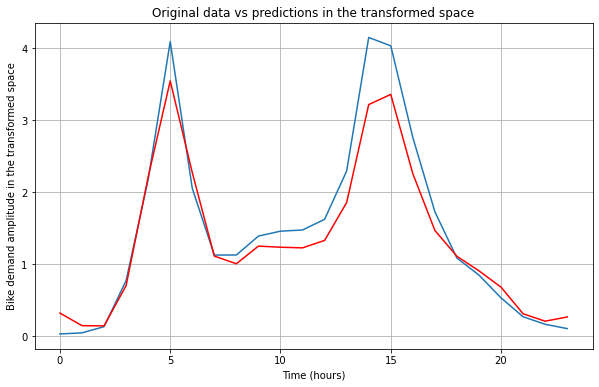

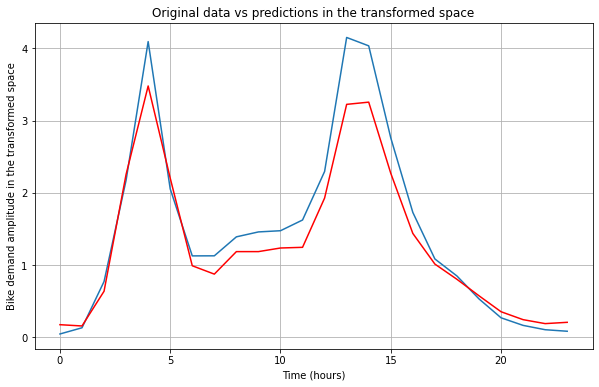

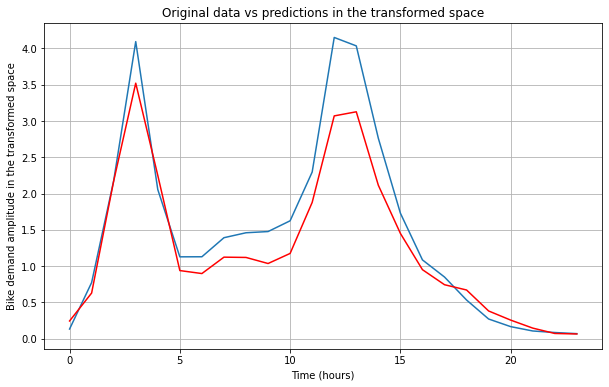

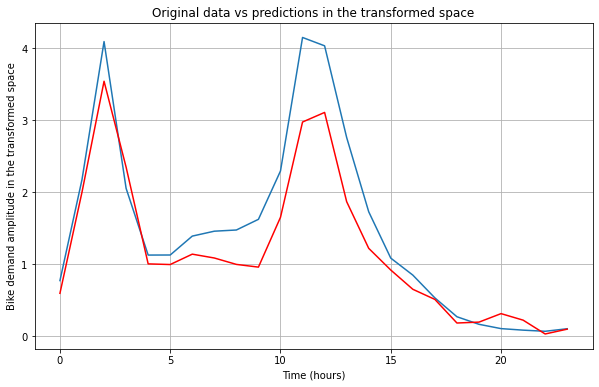

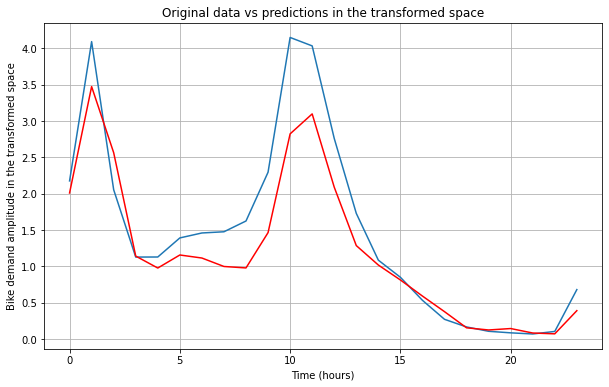

...

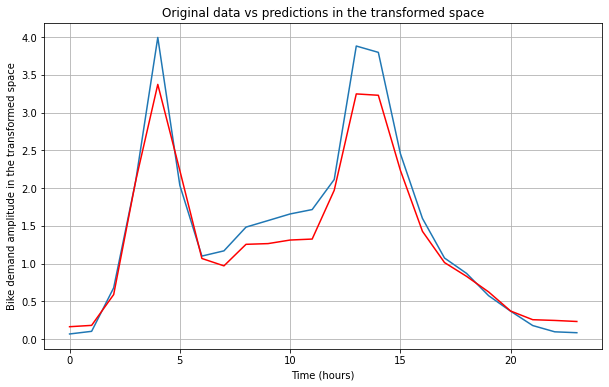

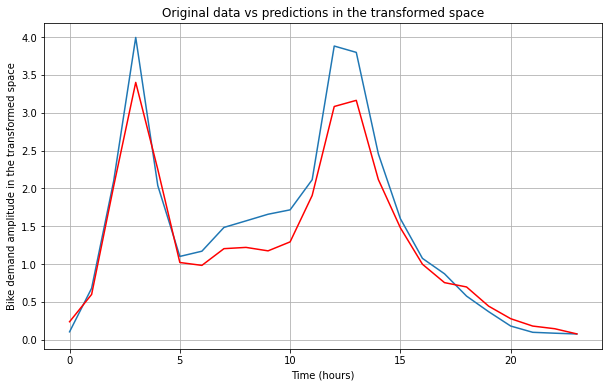

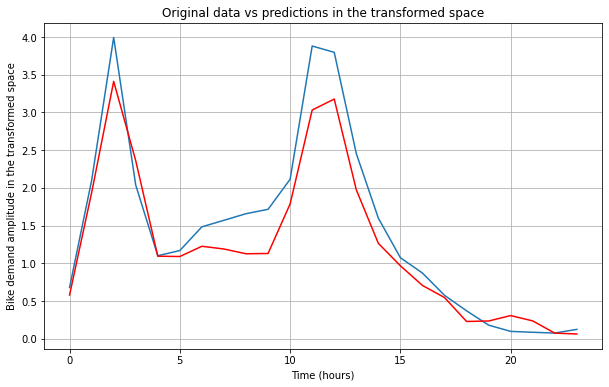

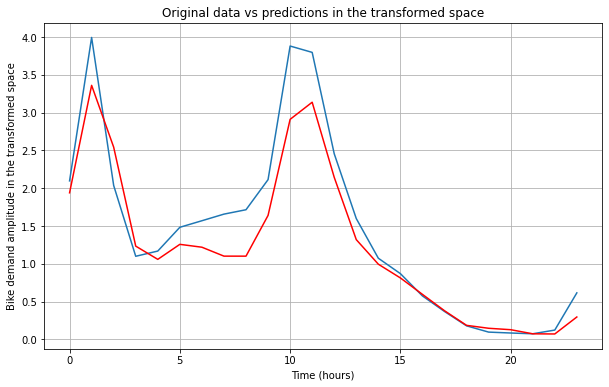

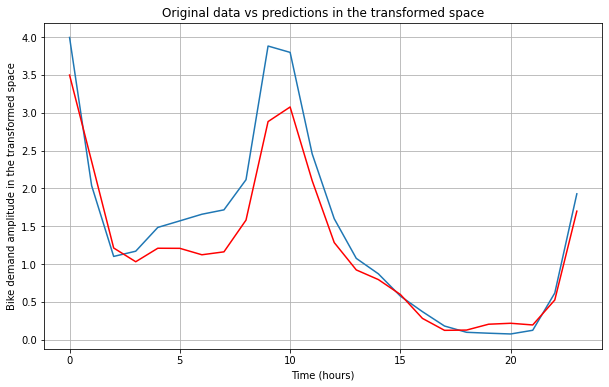

In [127]:
for i in range(0,30):
  the_day = i
  y_pred_days = y_pred[the_day,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_day,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')